# Time series data science project

- **Chess players patterns discovery and analysis**
- **ariel-zil**

## Part 2 : Feature analysis

# 1. Imports

## 1. Import packages

In [1]:
from dotenv import find_dotenv, load_dotenv
import os
import pandas as pd
import matplotlib.pyplot as plt
from tqdm import tqdm
from tslearn.clustering import TimeSeriesKMeans
import time
from sklearn import metrics
from tslearn.clustering import TimeSeriesKMeans
from tslearn.clustering import silhouette_score
import numpy as np
from warnings import filterwarnings
import pickle
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import MinMaxScaler

from tslearn.utils import to_time_series_dataset
from tslearn.preprocessing import TimeSeriesScalerMeanVariance
from collections import Counter
# import all packages and set plots to be embedded inline
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sb
from matplotlib import rcParams

%matplotlib inline
%config InlineBackend.figure_format = 'retina'
rcParams['figure.figsize'] = 10,6
base_color = sb.color_palette()[0]




filterwarnings("ignore")

## 1.2. enviroment variables loading

In [2]:
PROJECT_PATH=os.getenv('PROJECT_PATH')
NUMBER_OF_GAMES_MINIMUM=int(os.getenv('NUMBER_OF_GAMES_MINIMUM'))
FICS_MIN_YEAR=int(os.getenv('FICS_MIN_YEAR'))
FICS_MAX_YEAR=int(os.getenv('FICS_MAX_YEAR'))
MAX_K=int(os.getenv('MAX_K'))

## 1.3. Load clean players dataset

In [3]:
player_df=pd.read_csv(f"{PROJECT_PATH}/data/fics/interim/chess-games-clean-blitz-rated-vfinal-players.csv")

In [5]:
player_df

,Unnamed: 0,Result,FICSGamesDBGameNo,Player,Elo,Opponent,OpponentElo,Date,Time,Year,Month,Day,Hour,Minute,Second
0,0,Won,455505130,Strikko,1606,boggus,1607,2019.11.30,08:05:00,2019,11,30,8,5,0
1,1,Won,455505129,Wychbold,1311,Jarlaxle,1437,2019.11.30,08:07:00,2019,11,30,8,7,0
2,2,Lost,455505128,Shaderman,1567,tihibuda,1516,2019.11.30,08:06:00,2019,11,30,8,6,0
3,3,Lost,455505126,aussenschnapp,1680,SchachDieter,1698,2019.11.30,08:05:00,2019,11,30,8,5,0
4,4,Won,455505123,pfink,1288,Tojul,1174,2019.11.30,07:56:00,2019,11,30,7,56,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
27723453,14408055,Won,434845469,bretteux,1155,Arembepe,1059,2018.08.09,12:16:00,2018,8,9,12,16,0
27723454,14408056,Won,434845468,HWPer,1520,JonotheRed,1501,2018.08.09,12:12:00,2018,8,9,12,12,0
27723455,14408057,Lost,434845467,Jonfern,1676,snackking,1621,2018.08.09,12:13:00,2018,8,9,12,13,0
27723456,14408058,Lost,434845465,Jesuslovesall,1423,alza,1333,2018.08.09,12:14:00,2018,8,9,12,14,0


## 1.4. Sepearate by year

In [4]:
df_2018=player_df[player_df["Year"]==2018]

In [ ]:
df_2019=player_df[player_df["Year"]==2019]

In [ ]:
df_2020=player_df[player_df["Year"]==20230]

## 1.5. split the data based on time intervals
We will to create time frames which represent the games based on intervals
We will choose the best year to do so

In [4]:
def get_num_dats(seconds):
    days = seconds // (24 * 60 * 60)
    return int(days)

def to_interval(curr,days):
    curr["DaysSinceStart"]=curr["Timestamp"].apply(lambda t:get_num_dats(t))
    player_elo=[]
    start=min(curr["DaysSinceStart"])
    end=max(curr["DaysSinceStart"])
    for i in range(start,end,days):
        if len(curr[curr["DaysSinceStart"]==i])==0:
            index=max(curr[curr["DaysSinceStart"]<=i].index)
            player_elo.append(list(curr[curr.index==index]["Elo"].values)[0])
        else:
            index=max(curr[curr["DaysSinceStart"]==i].index)
            player_elo.append(list(curr[curr.index==index]["Elo"].values)[0])
    return player_elo


def total_dup(arr):
    c=0
    for i in range(1,len(arr)):
        if arr[i]==arr[i-1]:
            c=c+1
    return c

def get_first_interval(curr,intervals=[1,7,10,15,30,45,60,75,80,90]):
    for i in range(len(intervals)):
        c=total_dup(to_interval(curr,intervals[i]))
        if c>0:
            ""
        else:
            return intervals[i]
        
def merge_dict(dict_1,dict_2):
    merged_dict={k:v for k,v in dict_2.items()}
    for k,v in dict_1.items():
        merged_dict[k]=v
    return merged_dict

from datetime import datetime, timedelta
import pandas as pd

def create_weekly_intervals(dates, values):
    # Convert the input dates to datetime objects
    date_values = [(datetime.strptime(date, '%Y.%m.%d %H:%M:%S'), value) for date, value in zip(dates, values)]
    
    # Sort the date-value pairs by date
    date_values.sort(key=lambda x: x[0])
    
    weekly_intervals = []
    current_week_start = None
    current_interval = []

    for date, value in date_values:
        if current_week_start is None:
            current_week_start = date

        current_interval.append((date, value))

        # Check if we've reached the end of the current week
        if date.weekday() == 6:  # Sunday
            weekly_intervals.append((current_week_start.strftime('%Y-%U'), current_interval))
            current_week_start = None
            current_interval = []

    # If there are any remaining dates, add them to the last interval
    if current_interval:
        weekly_intervals.append((current_week_start.strftime('%Y-%U'), current_interval))

    return weekly_intervals

def get_interval(dates,values,interval):
    
    # Convert to DataFrame
    df = pd.DataFrame({'Date': pd.to_datetime(dates), 'Value': values})
    
    # Group by year
    grouped = df.groupby(df['Date'].dt.year)
    
    result={
        "Elo":[],
        "Date":[],
    }
    
    # Iterate over each group
    for year, group in grouped:
        
        # Iterate over each interval of 90 days
        start_date = pd.to_datetime([f'{year}-01-01 00:00:00']).min()
        while start_date.year == year:
            end_date = start_date + pd.Timedelta(days=interval)
            interval_data = group[(group['Date'] >= start_date) & (group['Date'] <= end_date)]
            result["Elo"].append(list(interval_data["Value"]))
            result["Date"].append(list(interval_data["Date"]))
                
            start_date = end_date + pd.Timedelta(days=1)
    return pd.DataFrame.from_dict(result)
def get_v(r):
    if len(r)>0:
        return r[-1]
    return None

def get_samples_interval(df,interval):
    groups={g:data for g,data in df.groupby("Player")}


    frames={}
    for g in (groups.keys()):
        curr=groups[g]
        curr["Timestamp"]=(curr["Date"]+" "+curr["Time"])
        curr=get_interval(curr["Timestamp"],curr["Elo"],interval)
        curr["Elo"]=curr["Elo"].apply(lambda r:get_v(r))
        curr["Date"]=curr["Date"].apply(lambda r:get_v(r))
        last=len(curr.index)-1
        frames[g]=curr[curr.index!=last]
    
    g=list(frames.keys())[0]
    frames[g]
    
    
    samples={"Player":list(frames.keys())}
    for i in frames[g].index:
        samples[i]=[]
    
    for g in frames.keys():
        for i in frames[g].index:
            curr=frames[g]
            samples[i].append(list(curr[curr.index==i]["Elo"])[0])
            
    samples_df=pd.DataFrame.from_dict(samples)
    samples_df=samples_df.dropna()
    samples_df.index=list(samples_df["Player"])
    samples_df=samples_df.drop(columns="Player")
    return samples_df

In [6]:
df_interval_2018=get_samples_interval(df_2018,90)
df_interval_2018

,0,1,2,3
ABCi,1458.0,1429.0,1457.0,1445.0
ABSBEGINNER,1317.0,1356.0,1289.0,1288.0
ADJUSTOR,1893.0,1862.0,1917.0,1939.0
AFCERGY,1532.0,1637.0,1600.0,1546.0
AFRF,1353.0,1387.0,1285.0,1344.0
...,...,...,...,...
zwartspeler,1821.0,1818.0,1812.0,1700.0
zwirek,951.0,963.0,1016.0,1051.0
zxtxf,1331.0,1362.0,1309.0,1398.0
zyrq,1496.0,1464.0,1402.0,1380.0


In [8]:
df_interval_2019=get_samples_interval(df_2019,90)
df_interval_2019

,0,1,2,3
ADJUSTOR,1946.0,1960.0,1884.0,1849.0
AFCERGY,1521.0,1611.0,1598.0,1619.0
AFRF,1429.0,1455.0,1431.0,1373.0
AGMC,1400.0,1408.0,1425.0,1379.0
AIDFAOAO,1363.0,1399.0,1371.0,1365.0
...,...,...,...,...
zurichess,2238.0,2254.0,2315.0,2399.0
zwartspeler,1779.0,1839.0,1820.0,1849.0
zwirek,1092.0,1065.0,1091.0,1099.0
zzpasha,1550.0,1670.0,1728.0,1680.0


In [9]:
df_interval_2020=get_samples_interval(df_2020,90)
df_interval_2020

,0,1,2,3
AFCERGY,1635.0,1691.0,1614.0,1631.0
AFRF,1451.0,1478.0,1394.0,1471.0
AGMC,1401.0,1372.0,1265.0,1269.0
AGTgtgregor,1407.0,1577.0,1619.0,1572.0
AIDFAOAO,1433.0,1442.0,1450.0,1436.0
...,...,...,...,...
zstella,1335.0,1497.0,1366.0,1416.0
zti,1554.0,1560.0,1562.0,1591.0
zwartepaard,1340.0,1300.0,1286.0,1298.0
zwartspeler,1799.0,1773.0,1788.0,1844.0


## 2. Clustering

### 2.1 Normalize the data

In [7]:

%%time

# Standardizing (z-score normalization) a dataset involves rescaling the distribution of values
ss = StandardScaler()

scaled_ss = ss.fit_transform(df_interval_2018.T)
df_ss = pd.DataFrame(scaled_ss.T, columns=df_interval_2018.columns, index=df_interval_2018.index)
X_ss = df_ss.values
display(df_ss.head())

# Normalization
mm = MinMaxScaler()
scaled_mm = mm.fit_transform(df_interval_2018.T)
df_mm = pd.DataFrame(scaled_mm.T, columns=df_interval_2018.columns, index=df_interval_2018.index)
X_mm = df_mm.values
display(df_mm.head())


# convert dataframe to time_series_dataset
X = to_time_series_dataset(df_interval_2018.values)

# normalize time series to zero mean and unit variance
X_train = TimeSeriesScalerMeanVariance().fit_transform(X)

print(X.shape, X_train.shape)

,0,1,2,3
ABCi,0.917807,-1.558137,0.832429,-0.192099
ABSBEGINNER,0.162565,1.571462,-0.848951,-0.885077
ADJUSTOR,-0.340862,-1.424627,0.498182,1.267306
AFCERGY,-1.109426,1.382333,0.504285,-0.777191
AFRF,0.292612,1.218082,-1.558328,0.047634


,0,1,2,3
ABCi,1.000000,0.0,0.965517,0.551724
ABSBEGINNER,0.426471,1.0,0.014706,0.000000
ADJUSTOR,0.402597,0.0,0.714286,1.000000
AFCERGY,0.000000,1.0,0.647619,0.133333
AFRF,0.666667,1.0,0.000000,0.578431


(5999, 4, 1) (5999, 4, 1)
CPU times: user 580 ms, sys: 0 ns, total: 580 ms
Wall time: 579 ms


### 2.2 Attempt kmeans clustering using euclidan distance

In [9]:
def kmeans_pipeline(x,metric,max_k=10):
    wcss = []
    calinski_harabasz=[]
    for i in range(2,max_k+1):
        start = time.time()
        model= TimeSeriesKMeans(n_clusters=i,metric=metric,n_jobs=-1,random_state=0)
        y_pred=model.fit_predict(x)
        
        score = metrics.calinski_harabasz_score(x, y_pred)

        print(model.inertia_,score)
        wcss.append(model.inertia_)
        calinski_harabasz.append(score)
        stop = time.time()
        duration = stop - start
        print(f"K = {i}.", f"Took {duration:.2f} seconds to calculate.")
    return wcss,calinski_harabasz

In [47]:
wcss_score_euclidean_x_ss,calinski_harabasz_euclidean_score_x_ss=kmeans_pipeline(X_ss,"euclidean",max_k=MAX_K)
wcss_score_euclidean_x_mm,calinski_harabasz_euclidean_score_x_mm=kmeans_pipeline(X_mm,"euclidean",max_k=MAX_K)

2.717387267723451 2779.0981500210196
K = 2. Took 2.74 seconds to calculate.
2.1230001433474692 2617.8845659325707
K = 3. Took 7.49 seconds to calculate.
1.6883846923321957 2708.43396770936
K = 4. Took 6.89 seconds to calculate.
1.4091103292344203 2730.432058220269
K = 5. Took 6.06 seconds to calculate.
1.1909794646421994 2803.673801912373
K = 6. Took 6.83 seconds to calculate.
1.0433564657527632 2809.7203306387364
K = 7. Took 7.40 seconds to calculate.
0.9149924772982796 2863.8065119637013
K = 8. Took 5.52 seconds to calculate.
0.8169360191831161 2896.0056595982655
K = 9. Took 6.15 seconds to calculate.
0.7442105742518824 2890.836923041531
K = 10. Took 6.96 seconds to calculate.
0.6816852483212031 2894.457846373501
K = 11. Took 6.86 seconds to calculate.
0.6178885117573817 2959.045795965465
K = 12. Took 6.94 seconds to calculate.
0.5789033760199797 2928.582214458475
K = 13. Took 7.06 seconds to calculate.
0.541504797065702 2920.5553031810155
K = 14. Took 7.31 seconds to calculate.
0.50

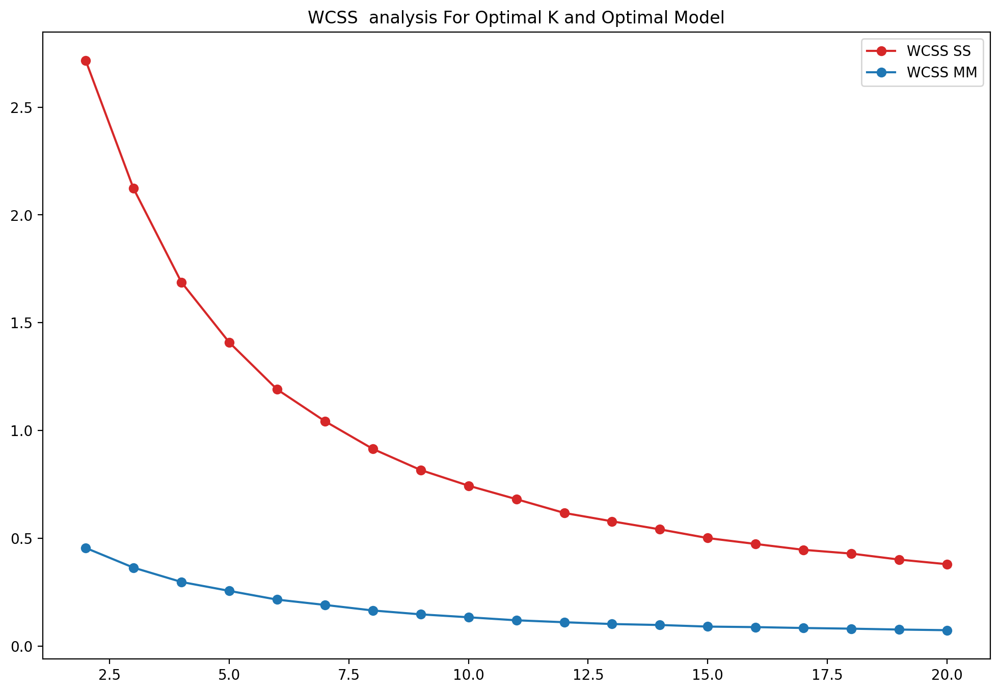

In [49]:
plt.figure(figsize=(12, 8))
plt.plot(range(2, MAX_K+1), wcss_score_euclidean_x_ss, "-o", c="C3")
plt.plot(range(2, MAX_K+1), wcss_score_euclidean_x_mm, "-o", c="C0")
plt.title("WCSS  analysis For Optimal K and Optimal Model")
plt.legend(["WCSS SS", "WCSS MM"]);

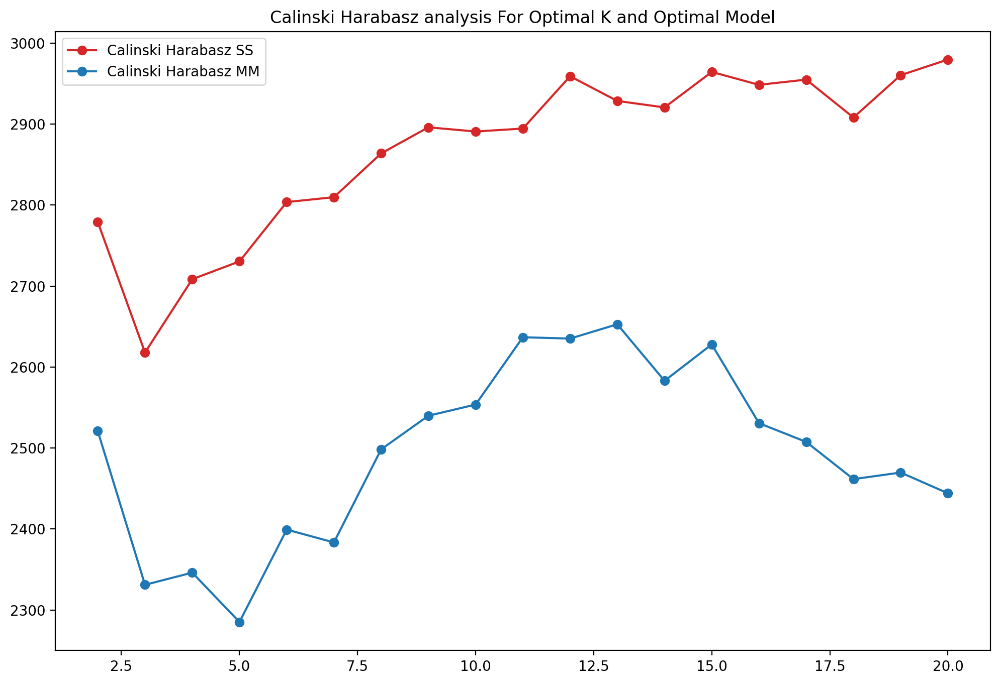

In [50]:
plt.figure(figsize=(12, 8))
plt.plot(range(2, MAX_K+1), calinski_harabasz_euclidean_score_x_ss, "-o", c="C3")
plt.plot(range(2, MAX_K+1), calinski_harabasz_euclidean_score_x_mm, "-o", c="C0")
plt.title("Calinski Harabasz analysis For Optimal K and Optimal Model")
plt.legend(["Calinski Harabasz SS", "Calinski Harabasz MM"]);

In [52]:
def get_best_calinski_harabasz(results):
    index=0
    for i in range(len(results)):
        if results[i]>results[index]:
            index=i
    return i  

print("The best for the case of ss:",get_best_calinski_harabasz(calinski_harabasz_euclidean_score_x_ss))
print("The best for the case of mm:",get_best_calinski_harabasz(calinski_harabasz_euclidean_score_x_mm))

The best for the case of ss: 18
The best for the case of mm: 18


So we can see that in the case of euclidan distance it is best to use K=18

In [10]:
def kmeans_cluster(n_clusters,algo,X_train,metric):
    model= TimeSeriesKMeans(n_clusters=n_clusters,
                        metric=metric,
                        n_jobs=-1,
                        random_state=0)
    y_pred = model.fit_predict(X_train)


    for yi in range(len(np.unique(y_pred))):
      for xx in X_train[y_pred == yi]:
        plt.plot(xx.ravel(), "k-", alpha=.2)


      plt.plot(model.cluster_centers_[yi].ravel(), "r-")
      plt.xlim(0, X_train.shape[1])
      plt.ylim(-5, 5)
      plt.text(0.55, 0.85,'Cluster %d' % (yi + 1), transform=plt.gca().transAxes)
      plt.title("kmeans")
      plt.tight_layout()
      plt.savefig(f"{PROJECT_PATH}/reports/figures/fics/{algo}-clusters-{(yi + 1)}-{n_clusters}-{metric}.png")
      plt.show();
  

    for i in range(len(np.unique(y_pred))):
      count = (sum(y_pred == i)/len(y_pred))*100
      print(f"The {count:.2f}% of the observations fall into Cluster {i + 1}")

    return y_pred


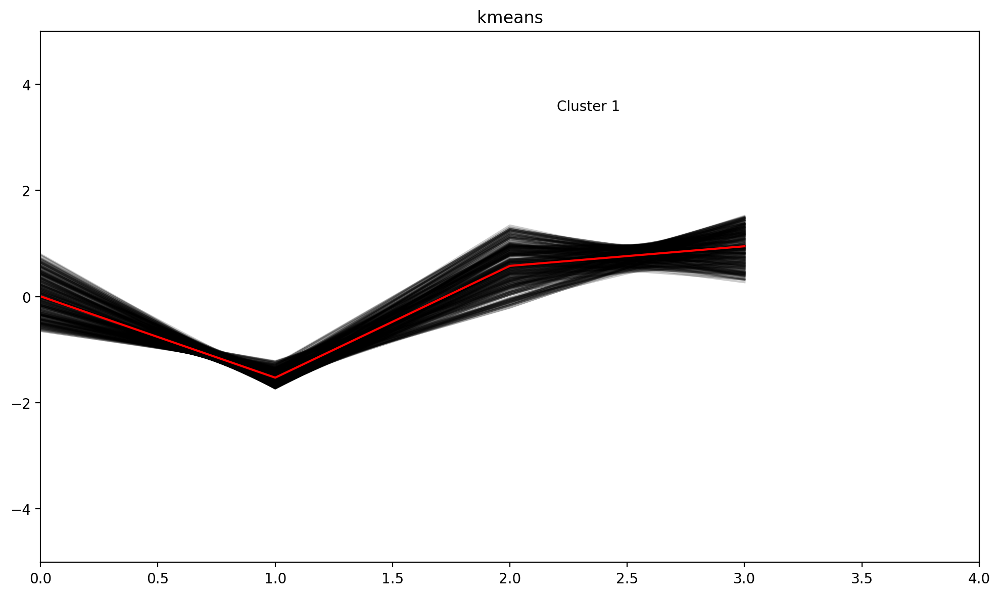

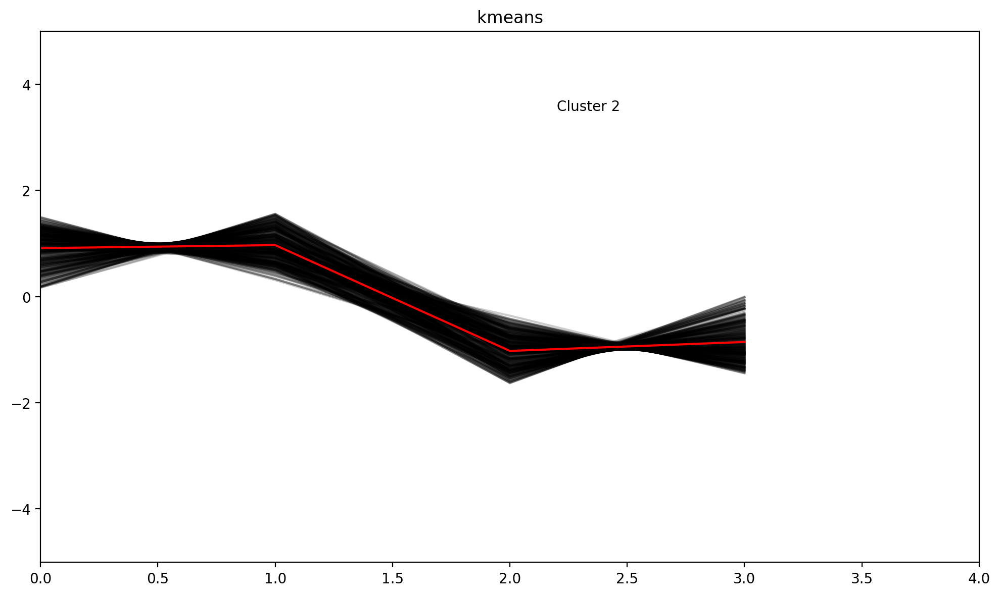

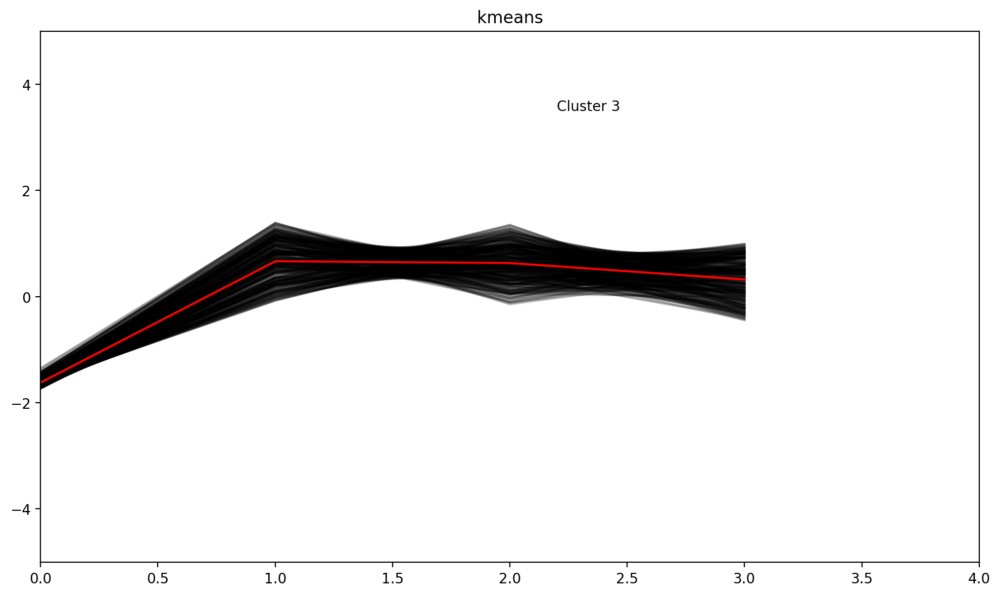

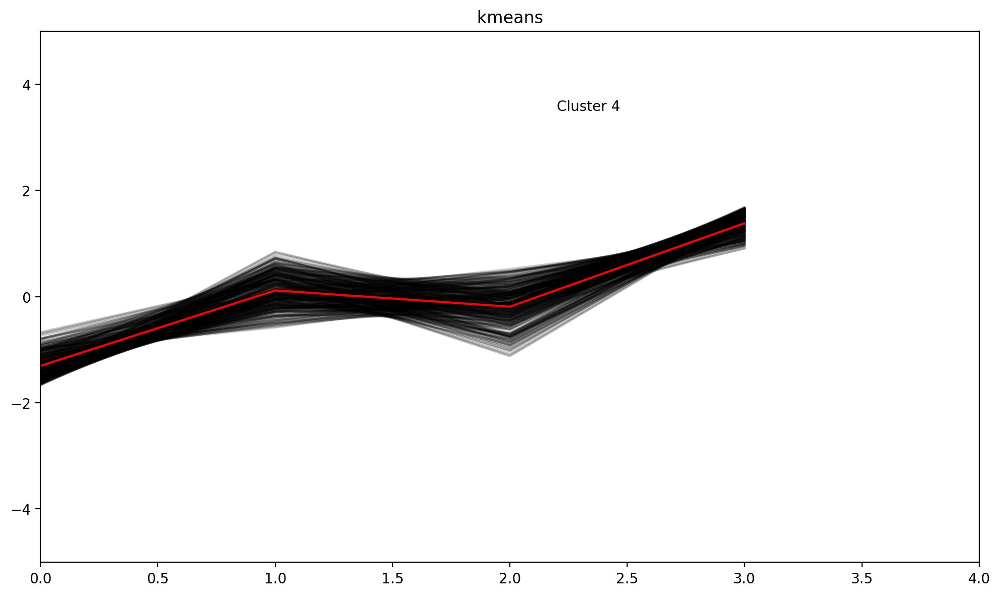

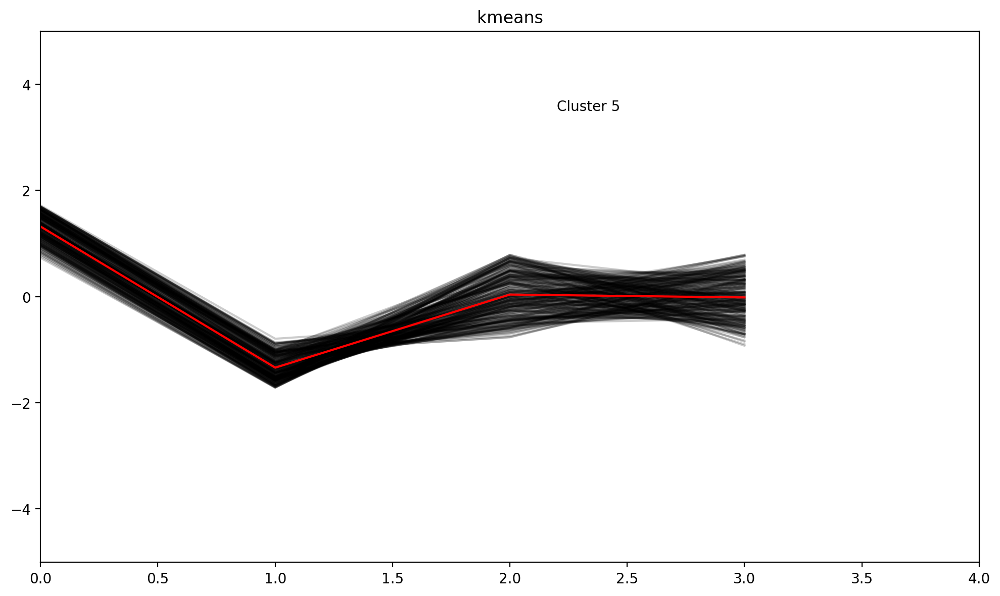

...

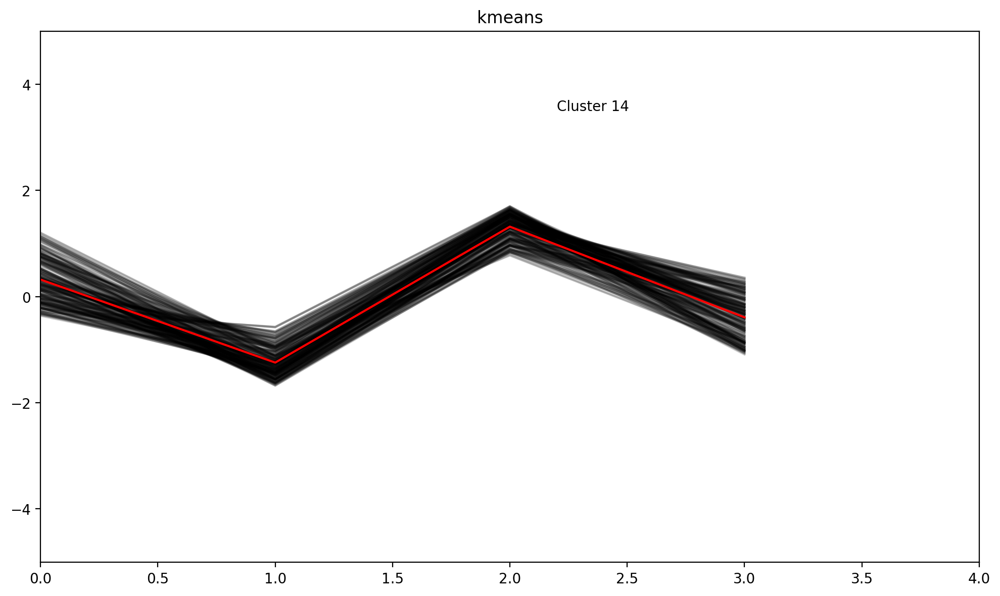

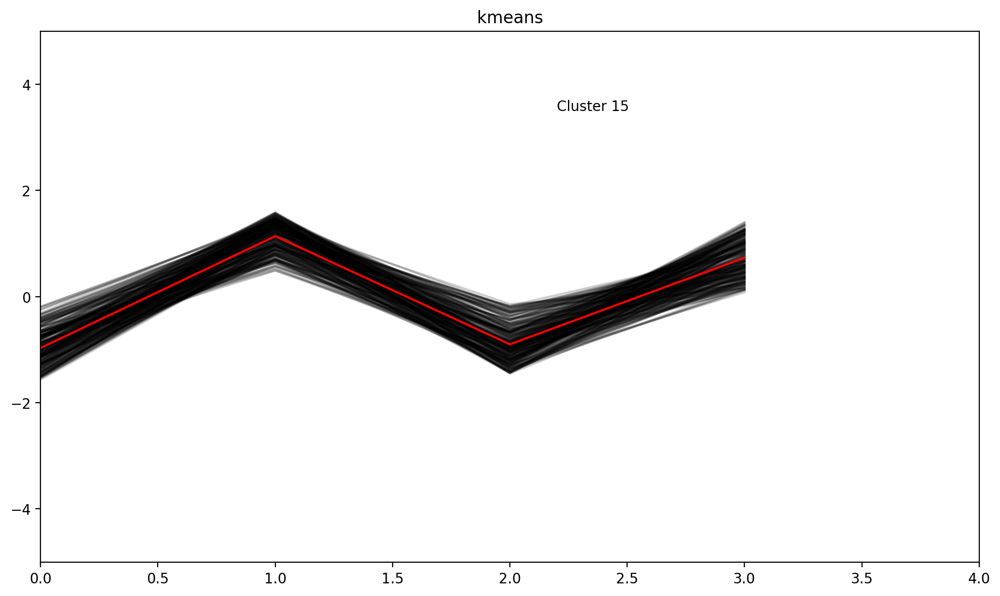

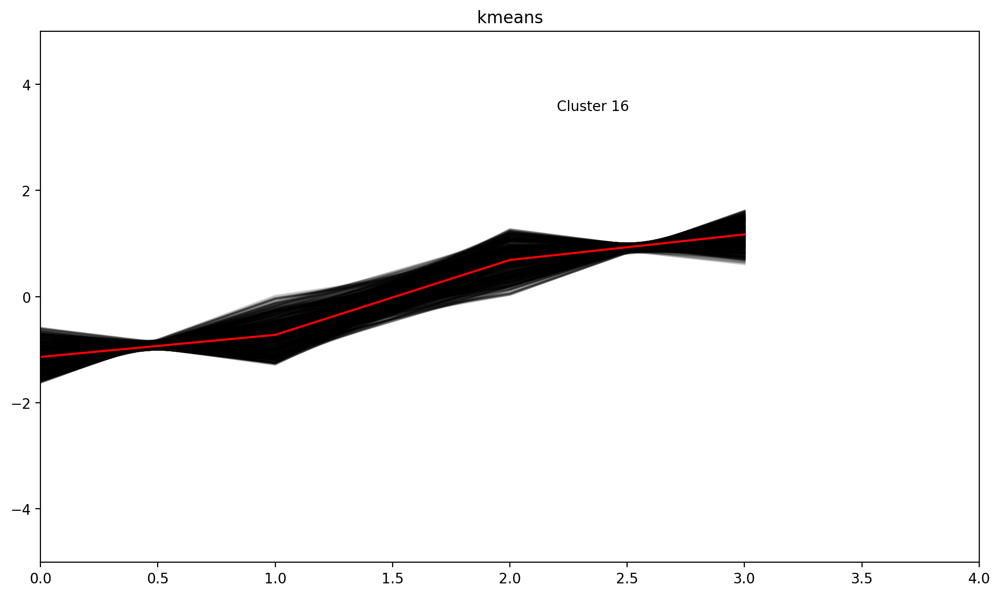

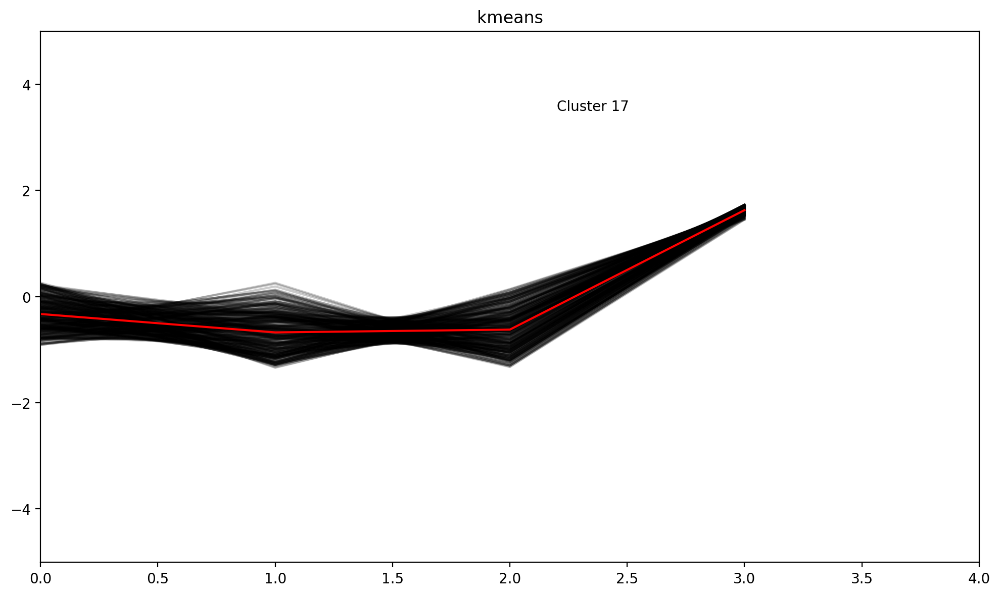

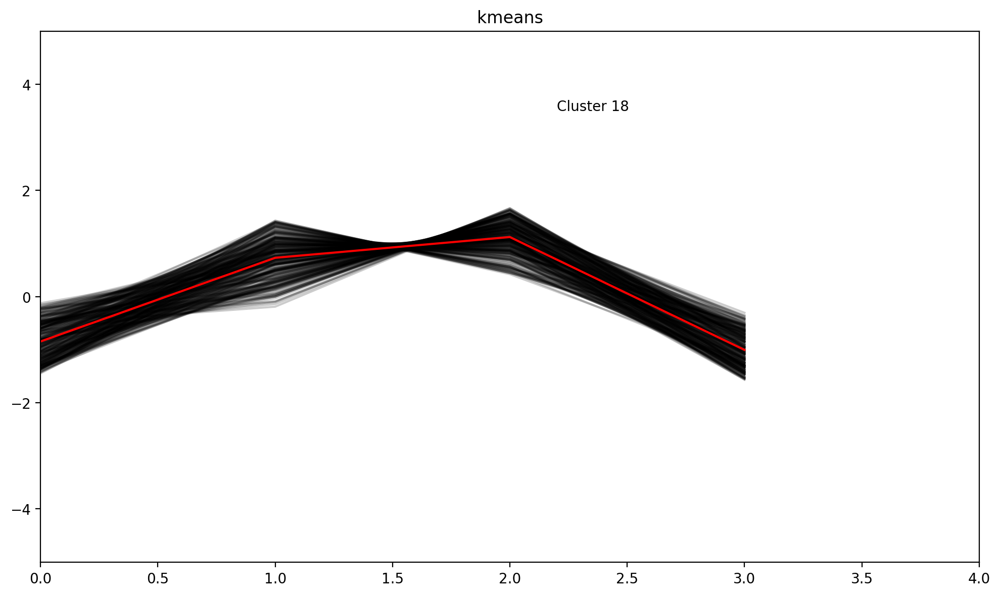

The 5.65% of the observations fall into Cluster 1
The 6.45% of the observations fall into Cluster 2
The 7.15% of the observations fall into Cluster 3
The 5.40% of the observations fall into Cluster 4
The 4.42% of the observations fall into Cluster 5
The 4.53% of the observations fall into Cluster 6
The 5.37% of the observations fall into Cluster 7
The 4.60% of the observations fall into Cluster 8
The 5.82% of the observations fall into Cluster 9
The 5.32% of the observations fall into Cluster 10
The 5.08% of the observations fall into Cluster 11
The 5.85% of the observations fall into Cluster 12
The 5.52% of the observations fall into Cluster 13
The 4.15% of the observations fall into Cluster 14
The 4.77% of the observations fall into Cluster 15
The 8.62% of the observations fall into Cluster 16
The 6.25% of the observations fall into Cluster 17
The 5.05% of the observations fall into Cluster 18


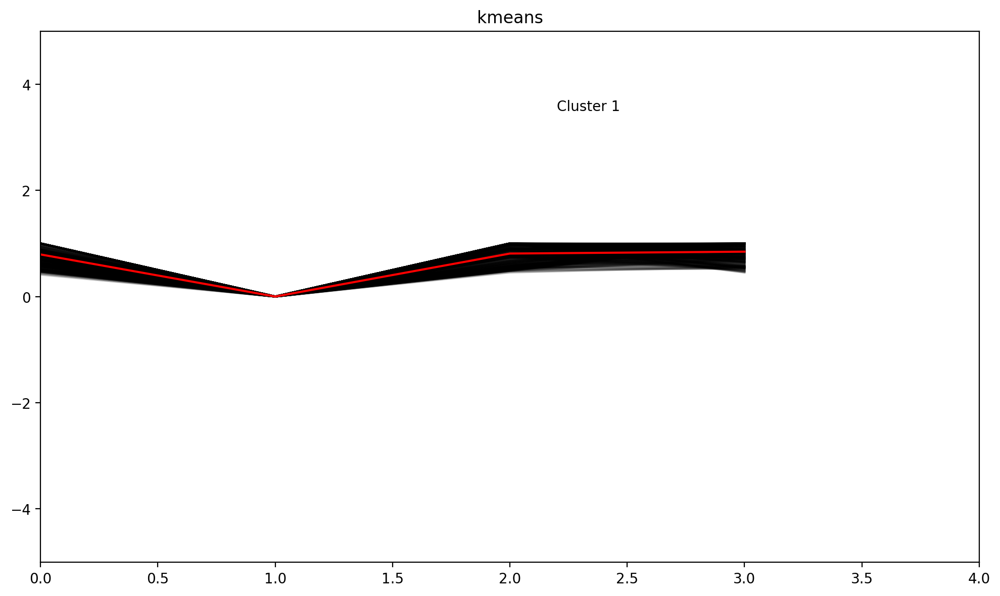

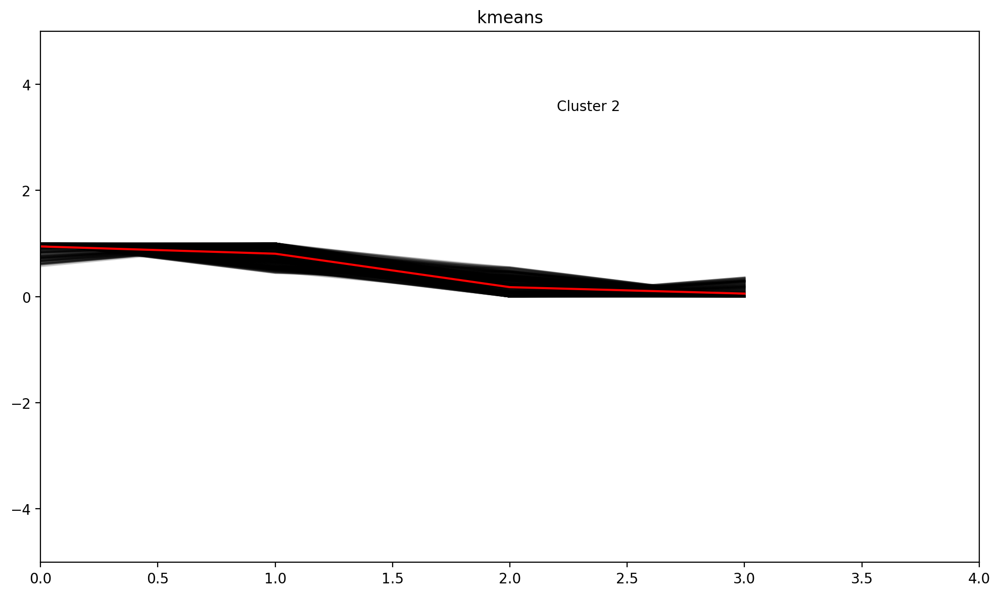

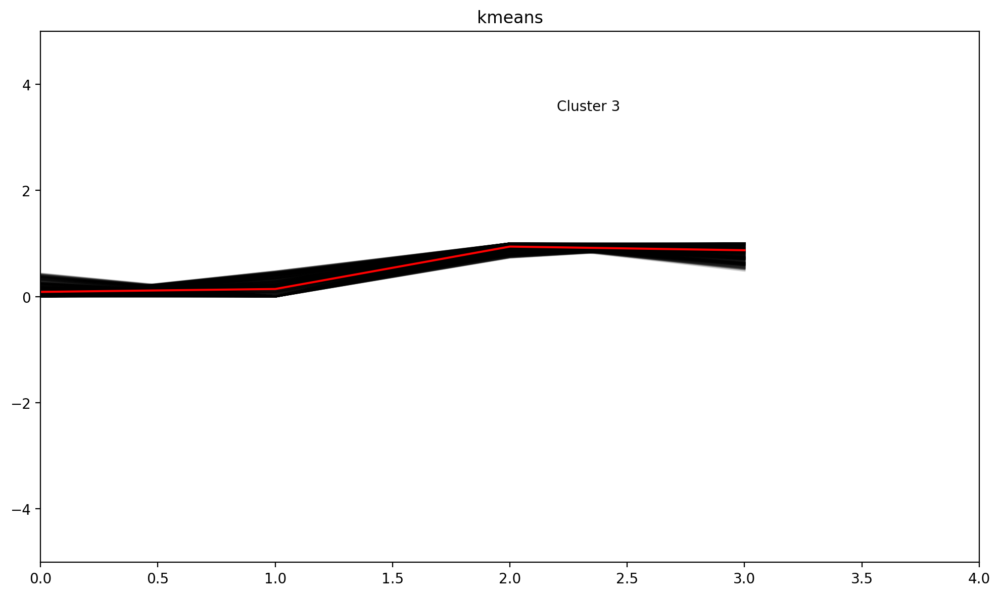

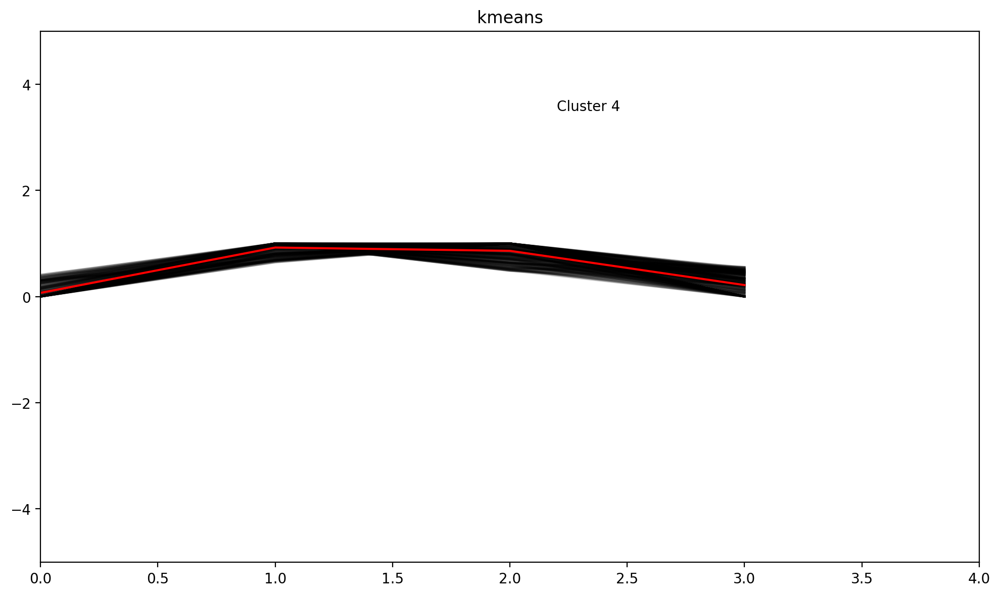

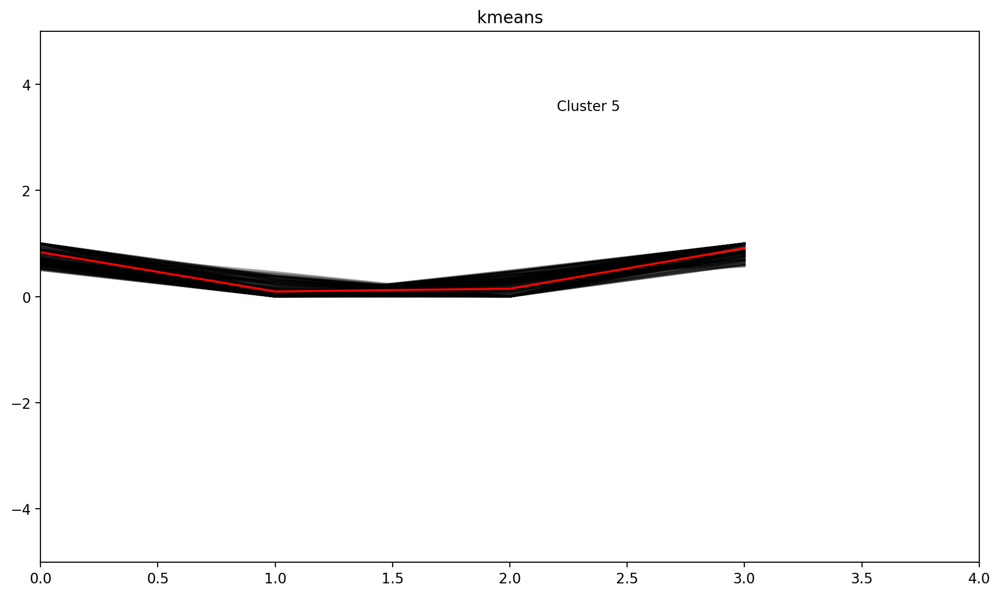

...

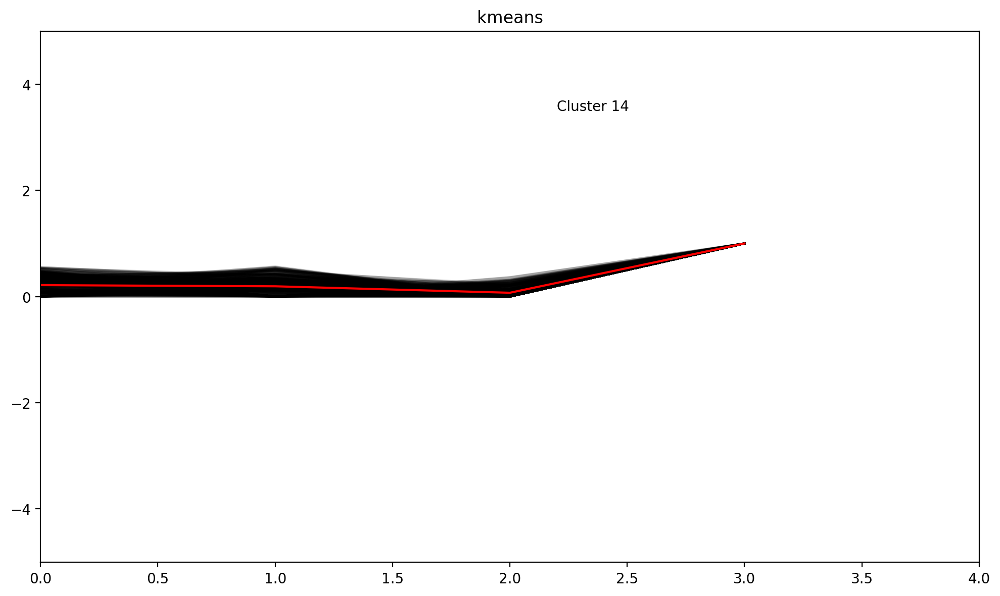

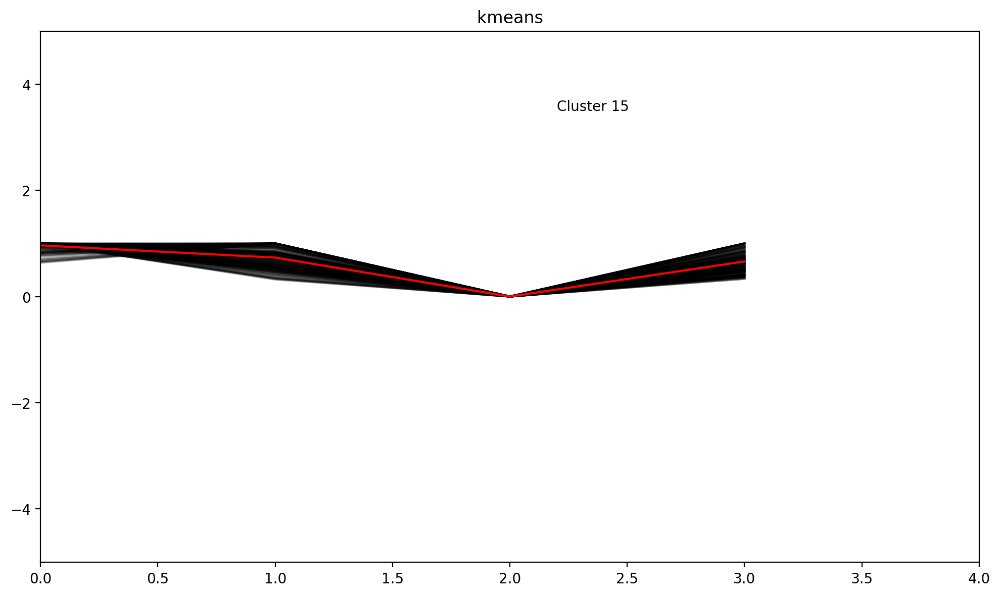

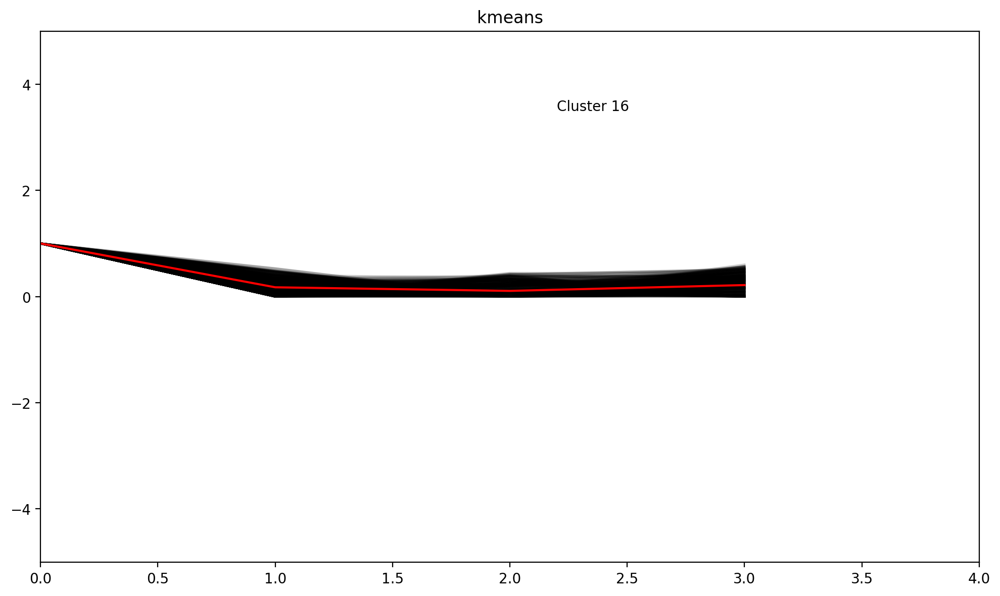

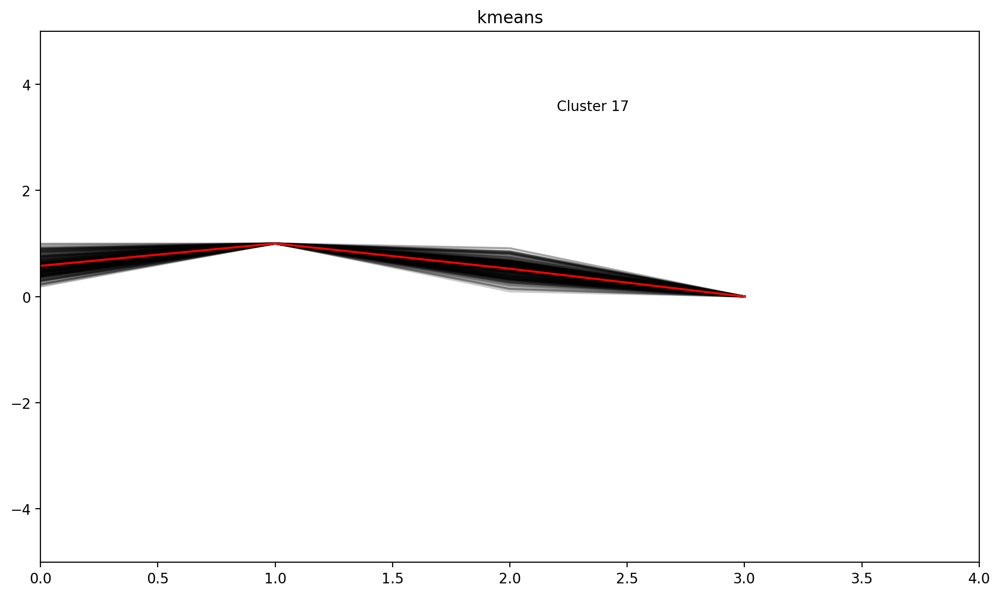

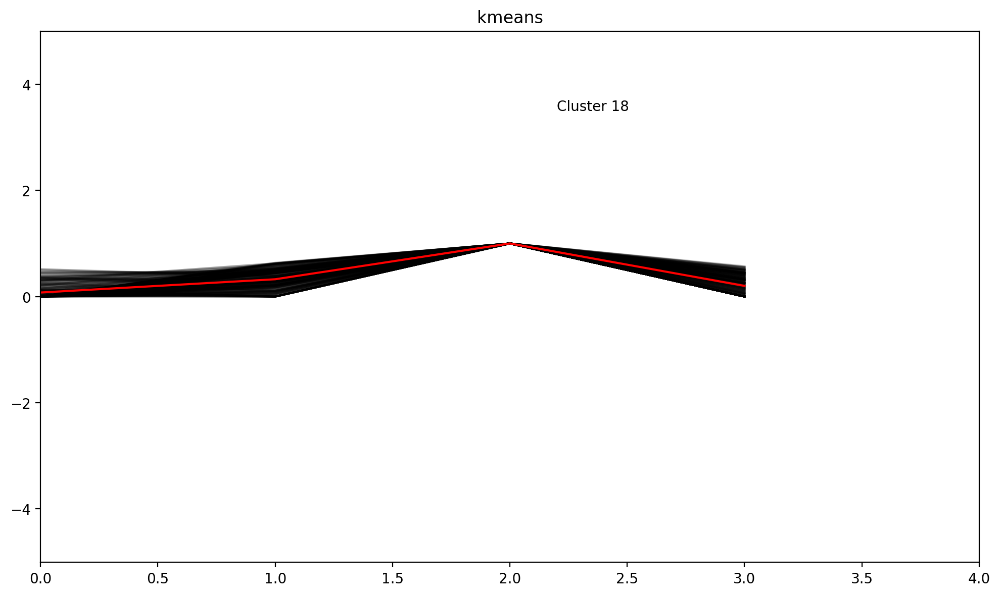

The 6.22% of the observations fall into Cluster 1
The 6.72% of the observations fall into Cluster 2
The 6.80% of the observations fall into Cluster 3
The 4.92% of the observations fall into Cluster 4
The 5.33% of the observations fall into Cluster 5
The 3.70% of the observations fall into Cluster 6
The 4.33% of the observations fall into Cluster 7
The 5.47% of the observations fall into Cluster 8
The 6.20% of the observations fall into Cluster 9
The 4.90% of the observations fall into Cluster 10
The 8.30% of the observations fall into Cluster 11
The 7.30% of the observations fall into Cluster 12
The 4.15% of the observations fall into Cluster 13
The 5.93% of the observations fall into Cluster 14
The 4.53% of the observations fall into Cluster 15
The 6.58% of the observations fall into Cluster 16
The 3.67% of the observations fall into Cluster 17
The 4.93% of the observations fall into Cluster 18


In [11]:
labels_x_ss=kmeans_cluster(18, "euclidean-ss",X_ss,"euclidean")
labels_x_mm=kmeans_cluster(18, "euclidean-mm",X_mm,"euclidean")

We will now plot the timne series in the unnormailized version 

In [20]:
import matplotlib.pyplot as plt

def plot_cluster(my_d):
        H=3
        W=len(my_d.keys())//H

        # Create a figure and a 2x2 grid of subplots
        for h in range(H):
                for w in range(W):
                        cluster_idx=W*h+w
                        plt.subplot(H, W, cluster_idx+1)
                        for i in range(min(len(my_d[cluster_idx]),20)):
                                plt.plot(my_d[cluster_idx][i], "k-", alpha=1)
                        plt.title(f"Cluster {cluster_idx}")
        plt.tight_layout()
        plt.show()


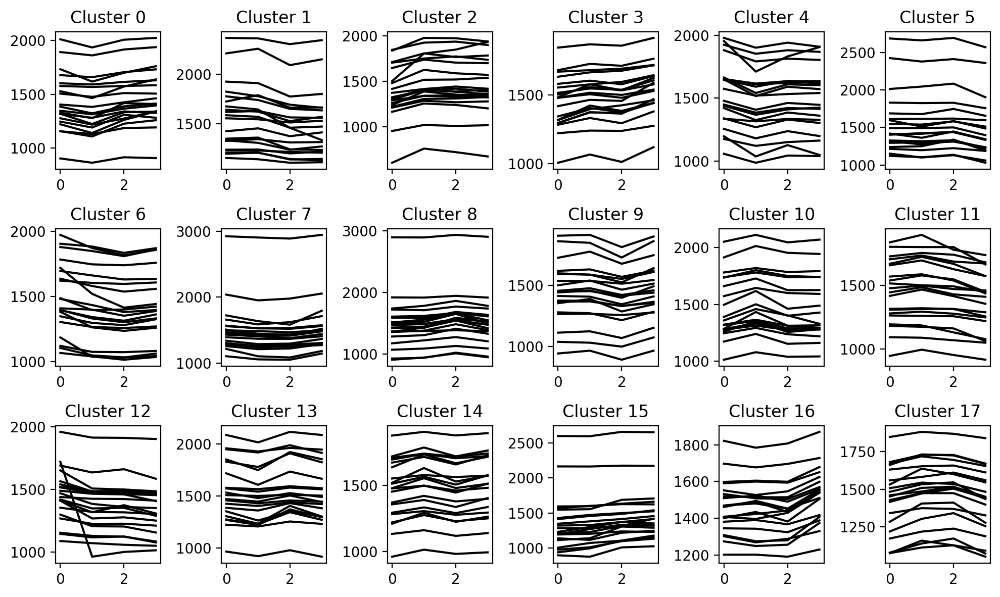

In [ ]:
groups=zip(labels_x_ss,X)
my_d_ss={}
for l,s in groups:
    my_d_ss[l]=my_d_ss.get(l,[])
    my_d_ss[l].append(s)
plot_cluster(my_d_ss)

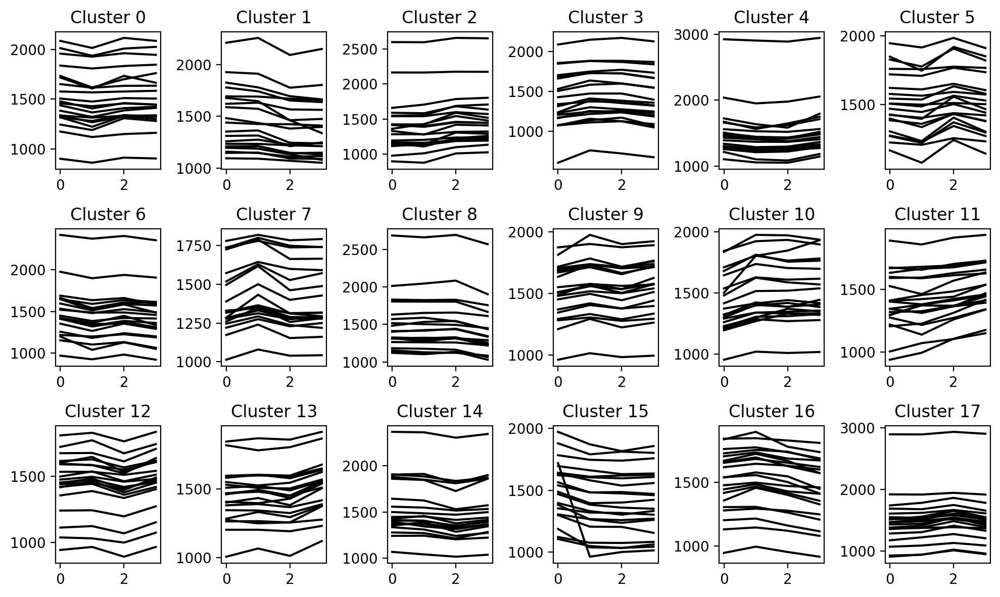

In [91]:
groups=zip(labels_x_mm,X)
my_d_mm={}
for l,s in groups:
    my_d_mm[l]=my_d_mm.get(l,[])
    my_d_mm[l].append(s)
    
plot_cluster(my_d_mm)

Lets add the clustering details

In [14]:
df_interval_2018["EuclidanClusterSSID"]=labels_x_ss
df_interval_2018["EuclidanClusterMMID"]=labels_x_mm

In [15]:
df_interval_2018

,0,1,2,3,EuclidanClusterSSID,EuclidanClusterMMID
ABCi,1458.0,1429.0,1457.0,1445.0,13,0
ABSBEGINNER,1317.0,1356.0,1289.0,1288.0,10,7
ADJUSTOR,1893.0,1862.0,1917.0,1939.0,0,11
AFCERGY,1532.0,1637.0,1600.0,1546.0,17,3
AFRF,1353.0,1387.0,1285.0,1344.0,9,14
...,...,...,...,...,...,...
zwartspeler,1821.0,1818.0,1812.0,1700.0,11,8
zwirek,951.0,963.0,1016.0,1051.0,15,11
zxtxf,1331.0,1362.0,1309.0,1398.0,9,12
zyrq,1496.0,1464.0,1402.0,1380.0,1,1


In [97]:
df_interval_2018.to_csv(f"{PROJECT_PATH}/data/fics/interim/chess-games-clean-blitz-rated-vfinal-players-interval-90-euclidan-cluster.csv")

In [9]:
df_interval_2018=pd.read_csv(f"{PROJECT_PATH}/data/fics/interim/chess-games-clean-blitz-rated-vfinal-players-interval-90-euclidan-cluster.csv")

In [18]:
def get_samples(df):
    groups={g:data for g,data in df.groupby("Player")}

    samples={"Player":list(groups.keys())}
    num_samples=0
    for k,v in groups.items():
        num_samples=max(num_samples,len(v))
    
    for k,v in groups.items():
        r=list(v.sort_values(by="FICSGamesDBGameNo")["Elo"])
        for i in range(num_samples):
            try:
                samples[i]=samples.get(i,[])
                samples[i].append(r[i])
            except Exception as err:    
                samples[i].append(0.0)
    return pd.DataFrame.from_dict(samples)


In [19]:
samples=get_samples(df_2018)
samples=samples[samples["Player"].isin(df_interval_2018.index)]

In [20]:
samples

,Player,0,1,2,3,4,5,6,7,8,...,21499,21500,21501,21502,21503,21504,21505,21506,21507,21508
5,ABCi,1495,1486.0,1502.0,1493.0,1490.0,1475.0,1474.0,1461.0,1450.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
8,ABSBEGINNER,1398,1409.0,1398.0,1409.0,1400.0,1405.0,1415.0,1422.0,1416.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
15,ADJUSTOR,1845,1839.0,1850.0,1844.0,1841.0,1838.0,1830.0,1840.0,1835.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
17,AFCERGY,1621,1626.0,1615.0,1605.0,1594.0,1584.0,1590.0,1596.0,1601.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
18,AFRF,1367,1361.0,1372.0,1381.0,1379.0,1375.0,1368.0,1375.0,1368.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
21085,zwartspeler,1843,1850.0,1854.0,1861.0,1865.0,1870.0,1875.0,1879.0,1883.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
21089,zwirek,994,985.0,951.0,1007.0,983.0,963.0,1016.0,994.0,1081.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
21090,zxtxf,1408,1381.0,1330.0,1326.0,1312.0,1329.0,1288.0,1265.0,1252.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
21092,zyrq,1449,1457.0,1465.0,1457.0,1466.0,1474.0,1479.0,1469.0,1460.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [21]:
samples["EuclidanClusterSSID"]=labels_x_ss
samples["EuclidanClusterMMID"]=labels_x_mm

In [22]:
X_samples = to_time_series_dataset(samples.drop(columns="Player").values)

In [23]:
X_samples2=[]
for i in range(len(X_samples)):
    curr=X_samples[i][X_samples[i]>0]
    curr=curr[:-1]
    curr=curr[:-1]
    while True:
        if curr[-1]!=0:
            break
        curr=curr[:-1]
    X_samples2.append(curr)



In [24]:
def plot_group(labels_x_mm,X_samples2,cluster_idx):
    groups=zip(labels_x_mm,X_samples2)
    my_d_mm={}
    for l,s in groups:
        my_d_mm[l]=my_d_mm.get(l,[])
        my_d_mm[l].append(s)
        
    for i in range(min(len(my_d_mm[cluster_idx]),15)):
        plt.plot(my_d_mm[cluster_idx][i])
        

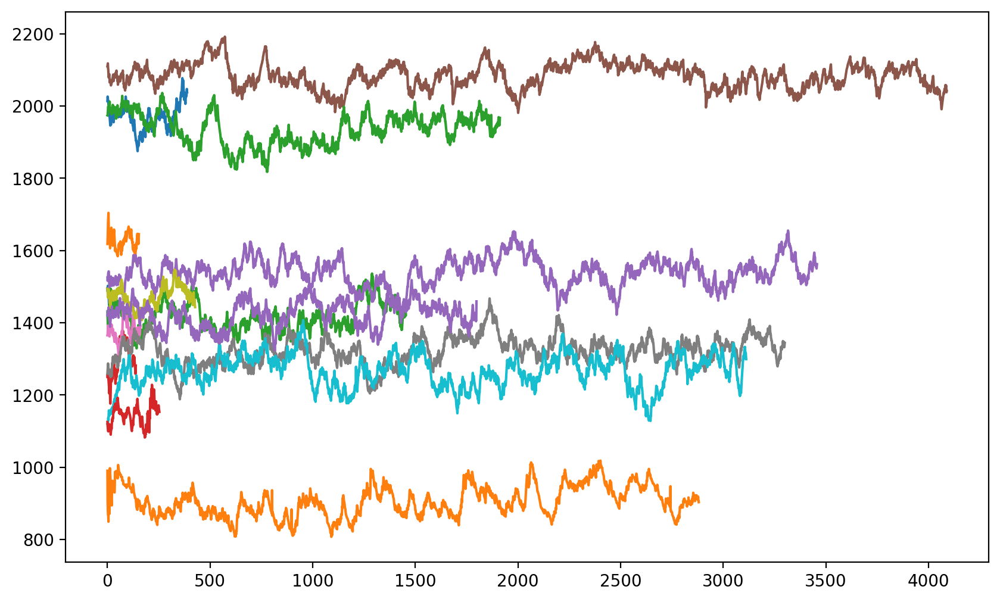

In [25]:
plot_group(labels_x_mm,X_samples2,0)

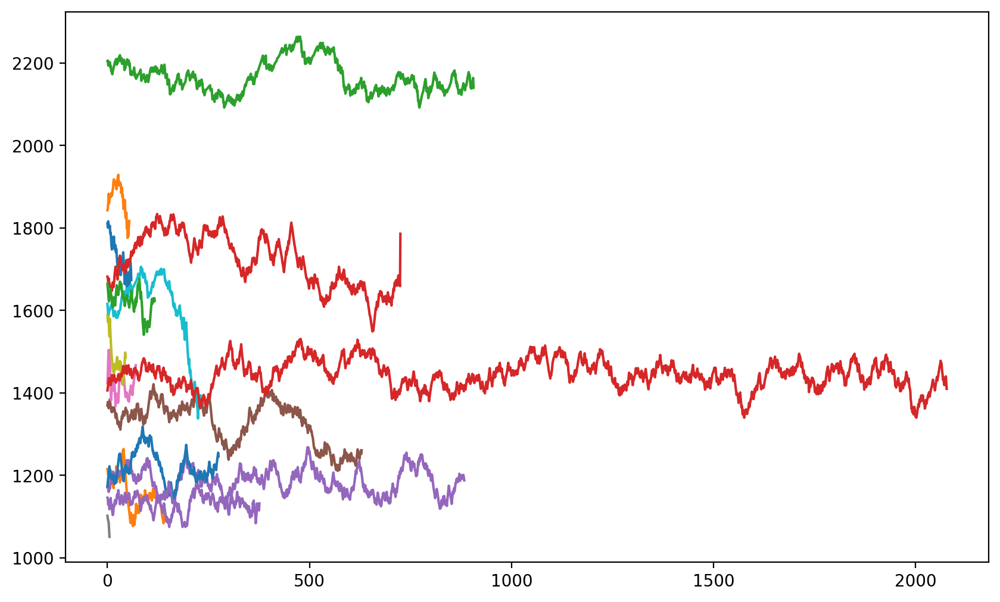

In [71]:
plot_group(labels_x_mm,X_samples2,1)

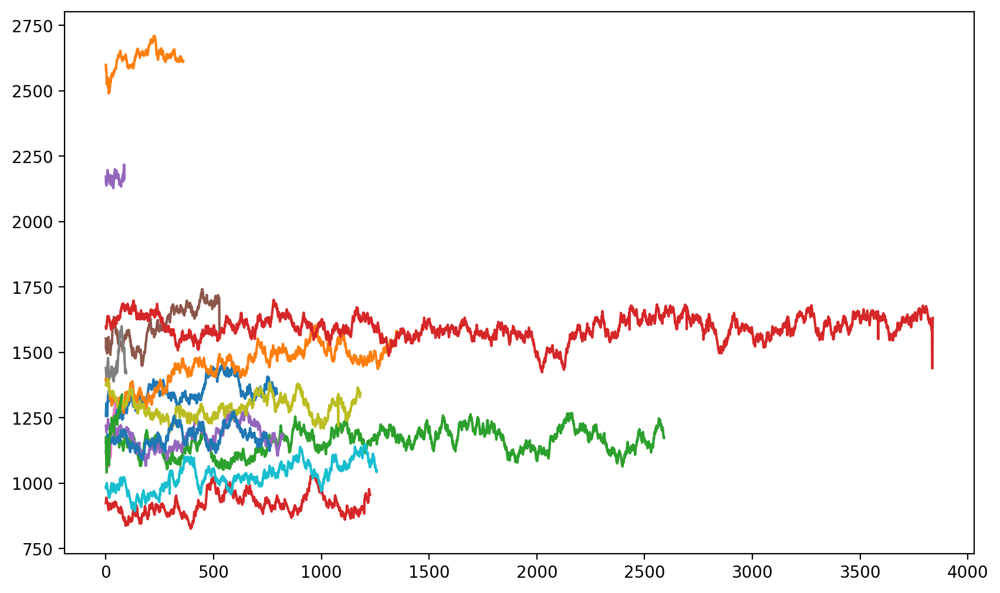

In [72]:
plot_group(labels_x_mm,X_samples2,2)

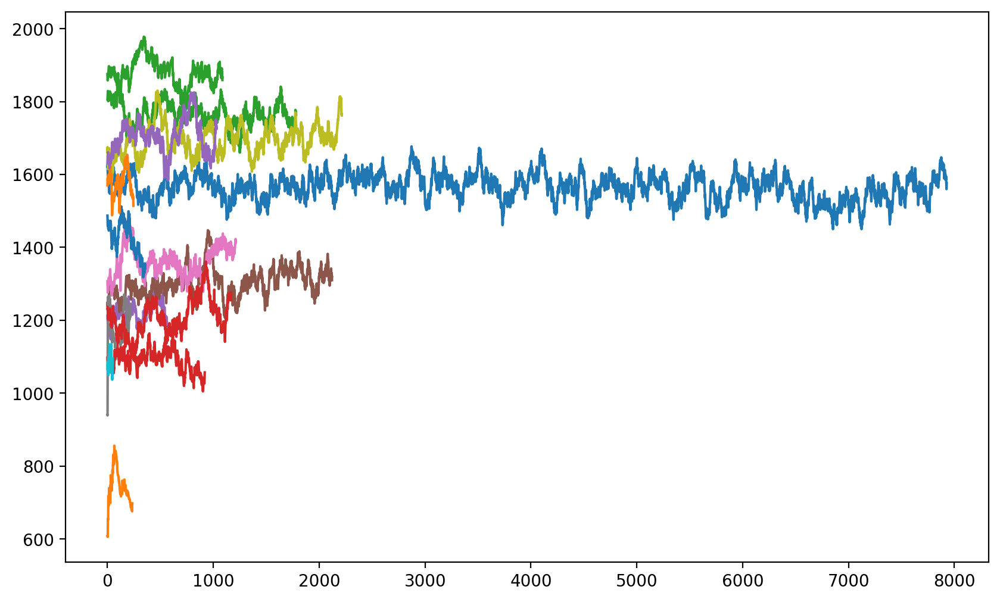

In [73]:
plot_group(labels_x_mm,X_samples2,3)

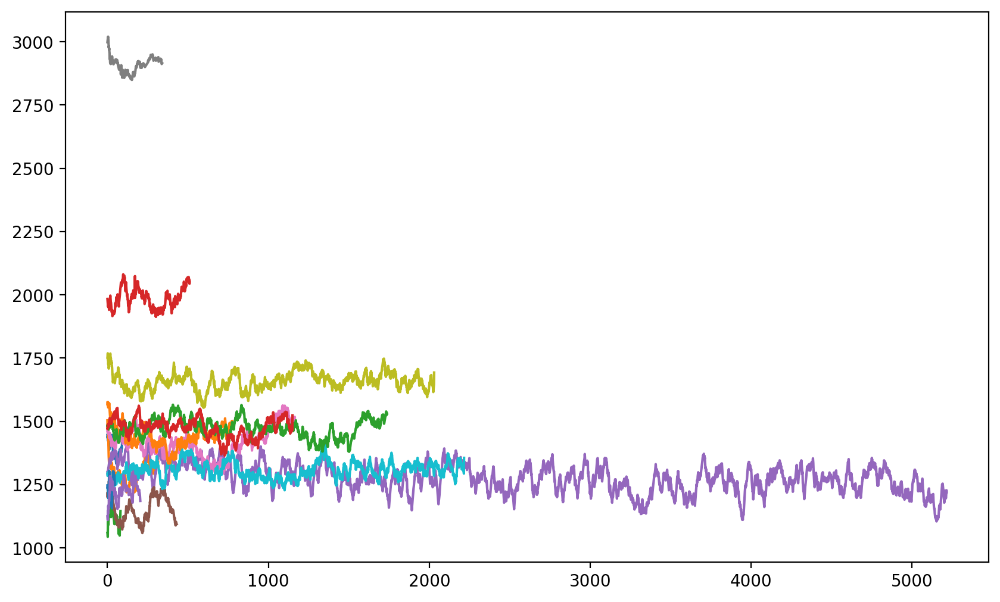

In [74]:
plot_group(labels_x_mm,X_samples2,4)

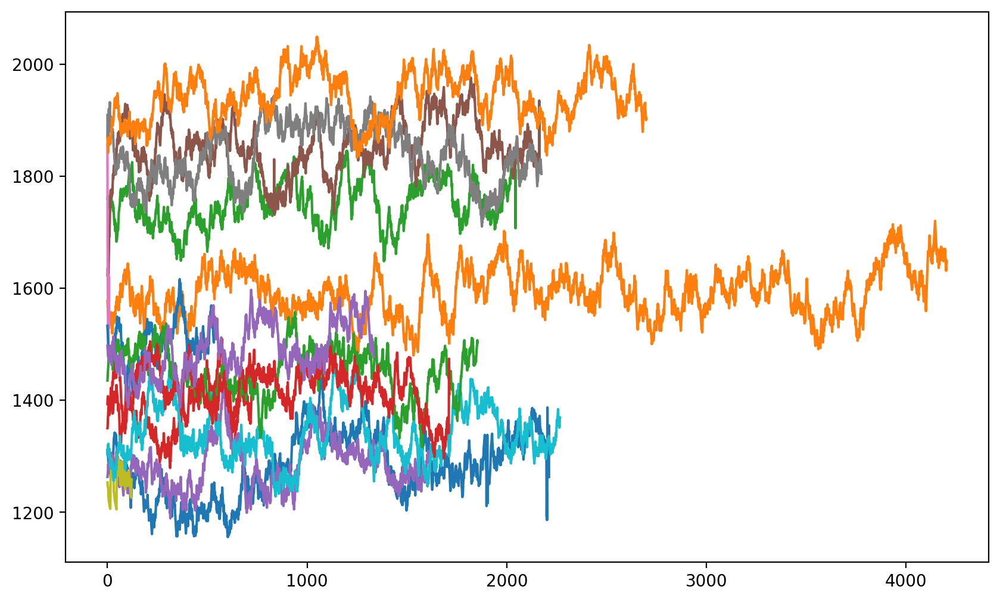

In [75]:
plot_group(labels_x_mm,X_samples2,5)

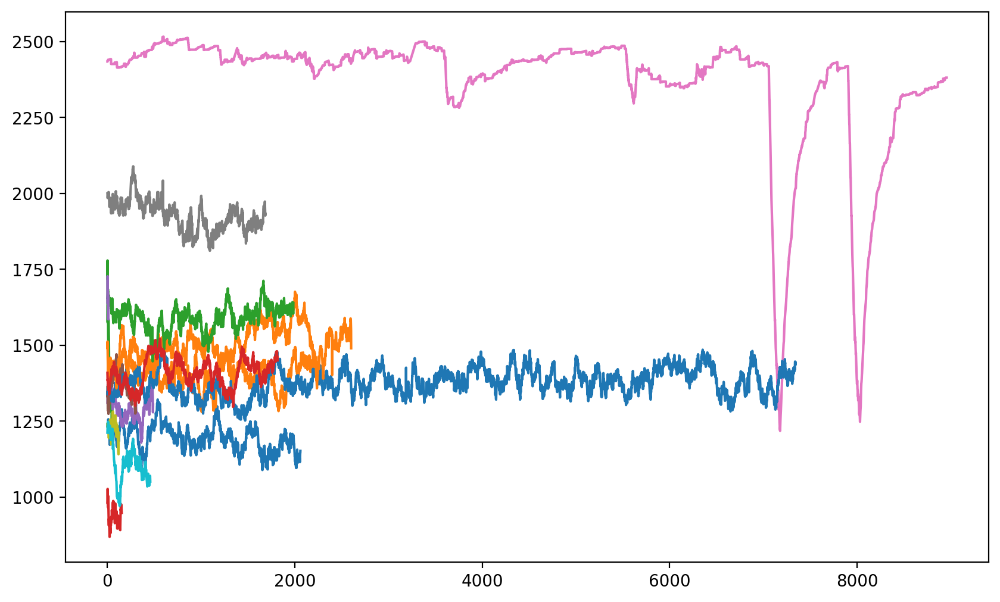

In [76]:
plot_group(labels_x_mm,X_samples2,6)

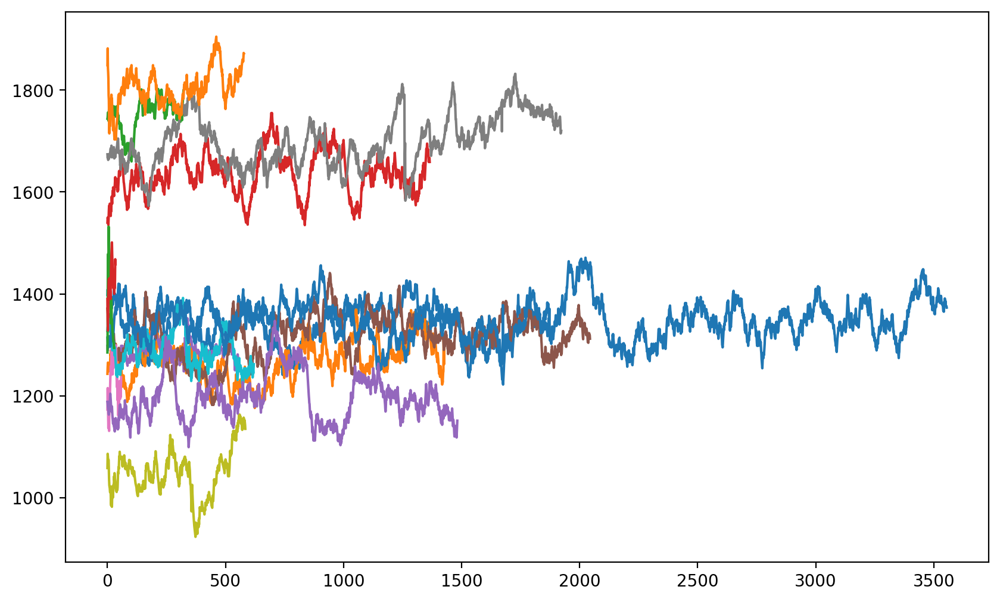

In [77]:
plot_group(labels_x_mm,X_samples2,7)

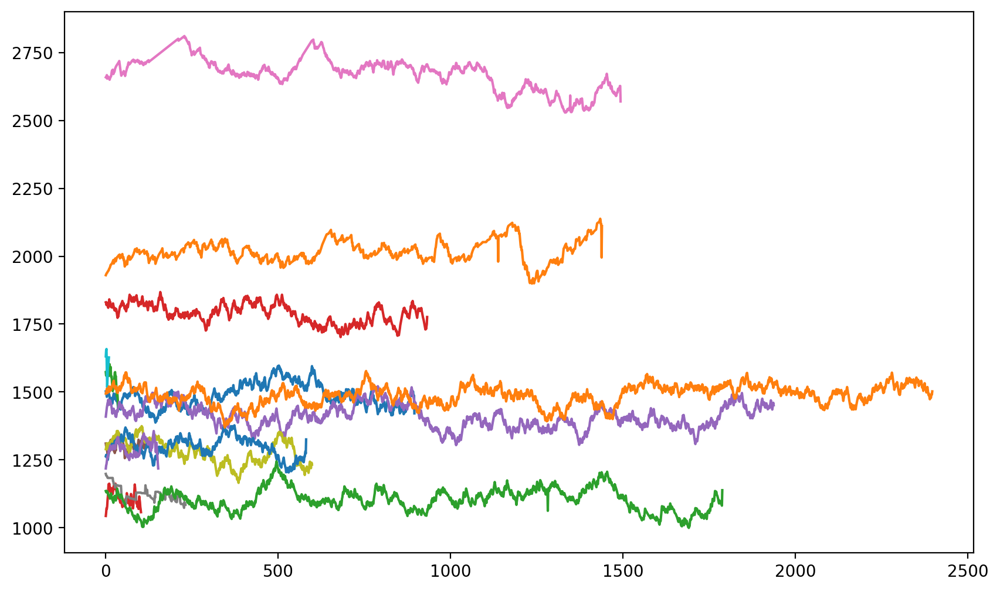

In [78]:
plot_group(labels_x_mm,X_samples2,8)

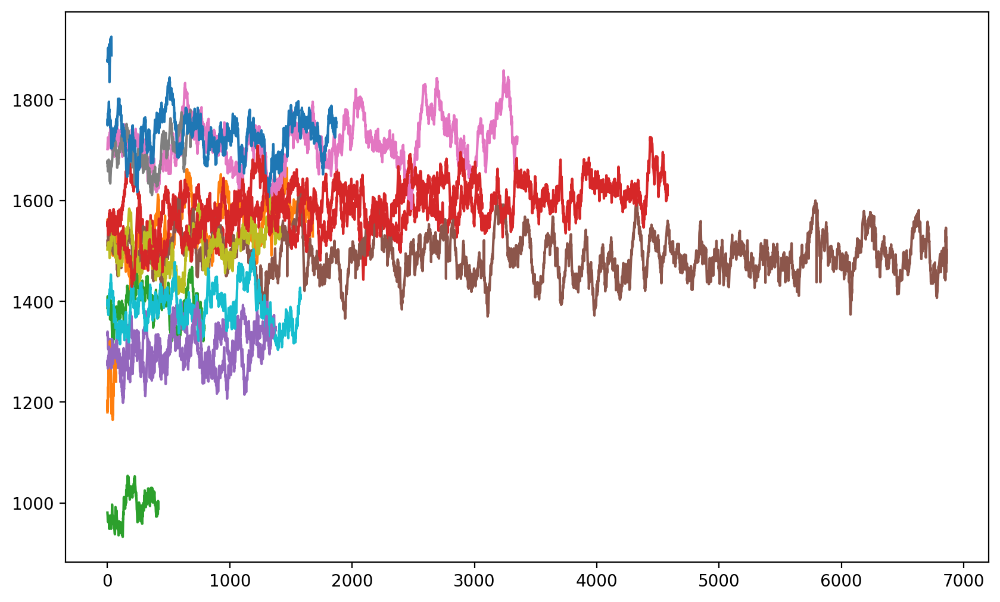

In [79]:
plot_group(labels_x_mm,X_samples2,9)

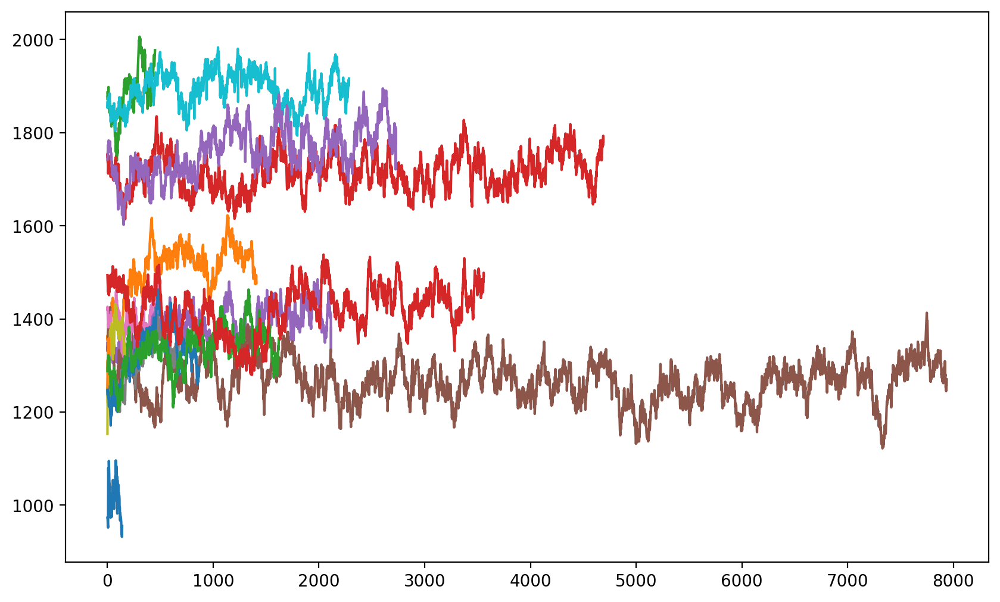

In [80]:
plot_group(labels_x_mm,X_samples2,10)

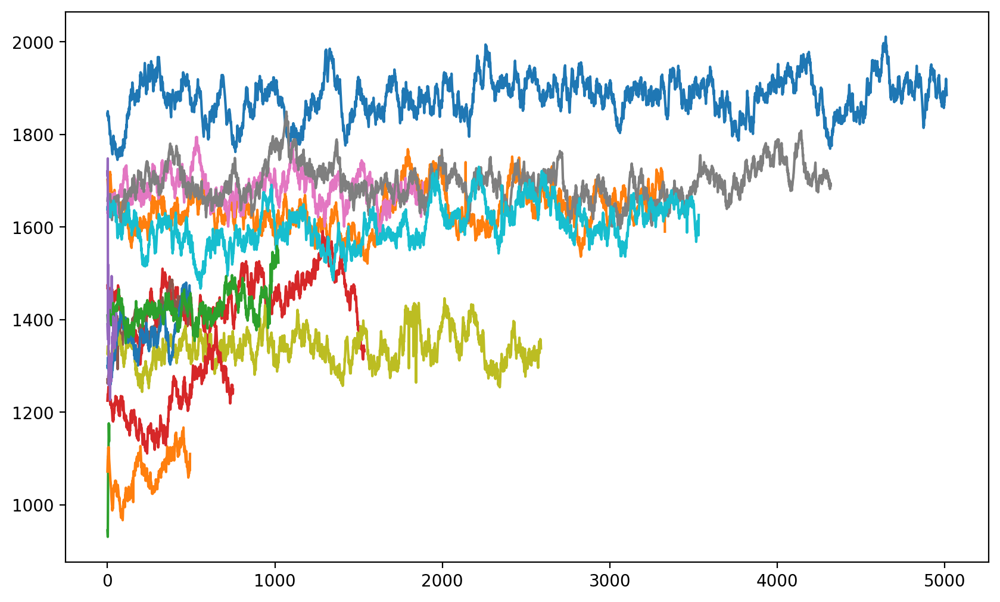

In [81]:
plot_group(labels_x_mm,X_samples2,11)

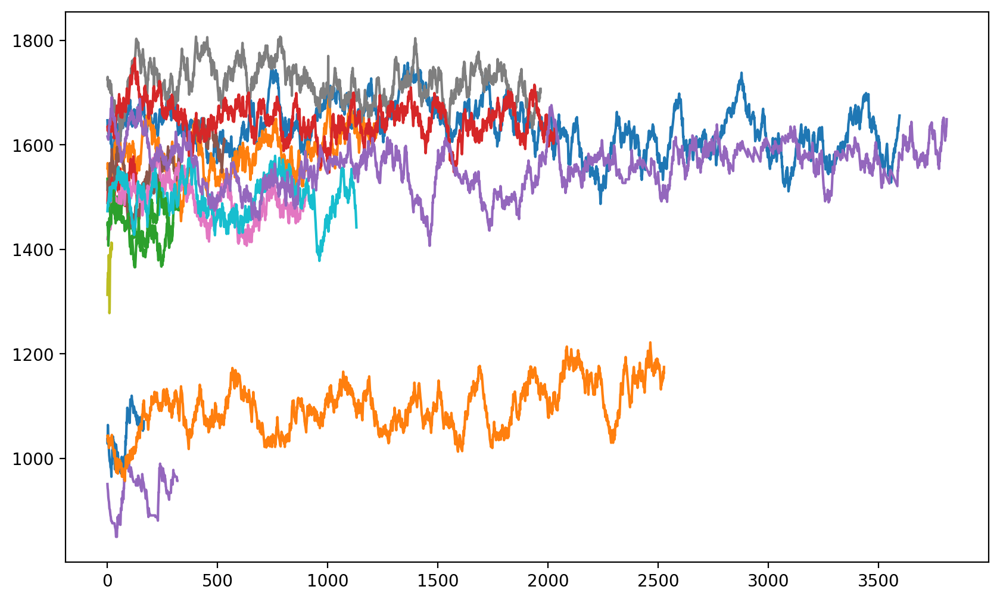

In [82]:
plot_group(labels_x_mm,X_samples2,12)

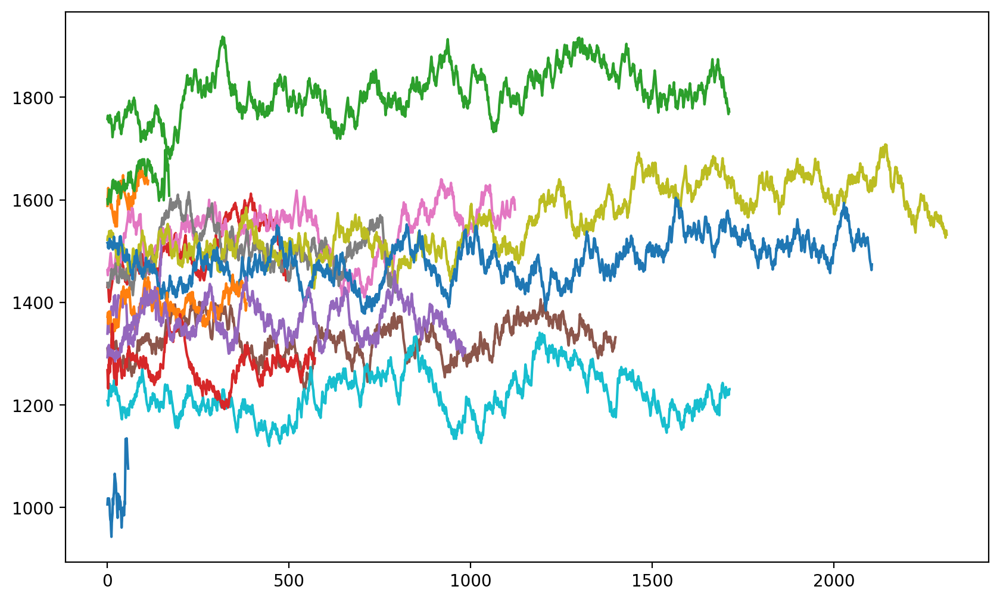

In [83]:
plot_group(labels_x_mm,X_samples2,13)

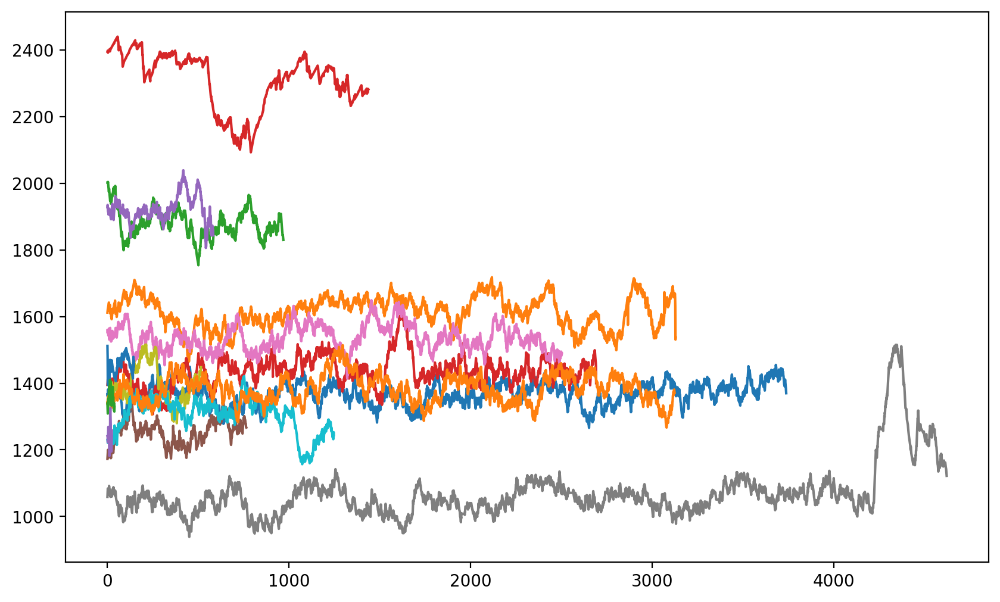

In [84]:
plot_group(labels_x_mm,X_samples2,14)

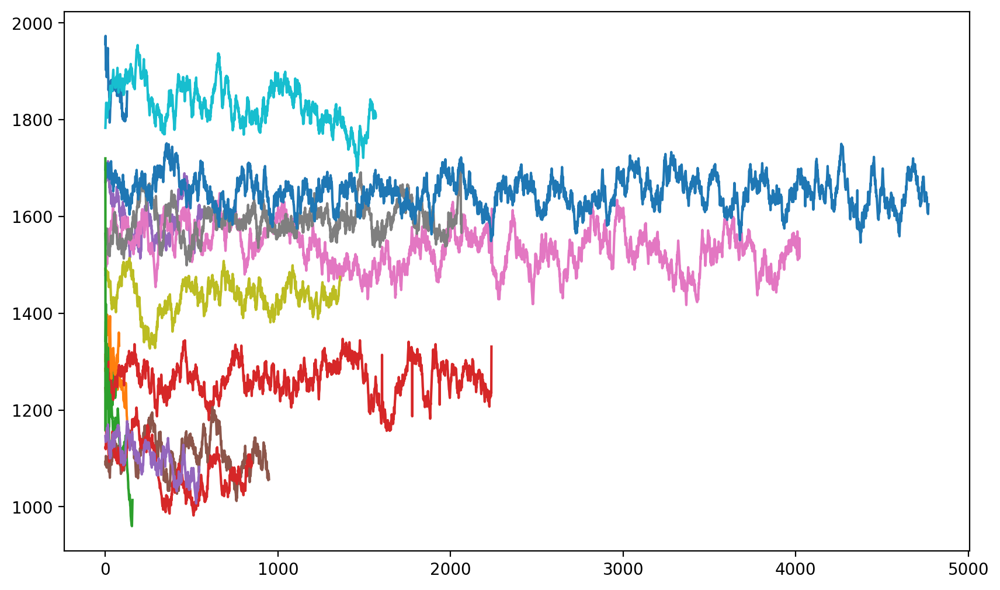

In [85]:
plot_group(labels_x_mm,X_samples2,15)

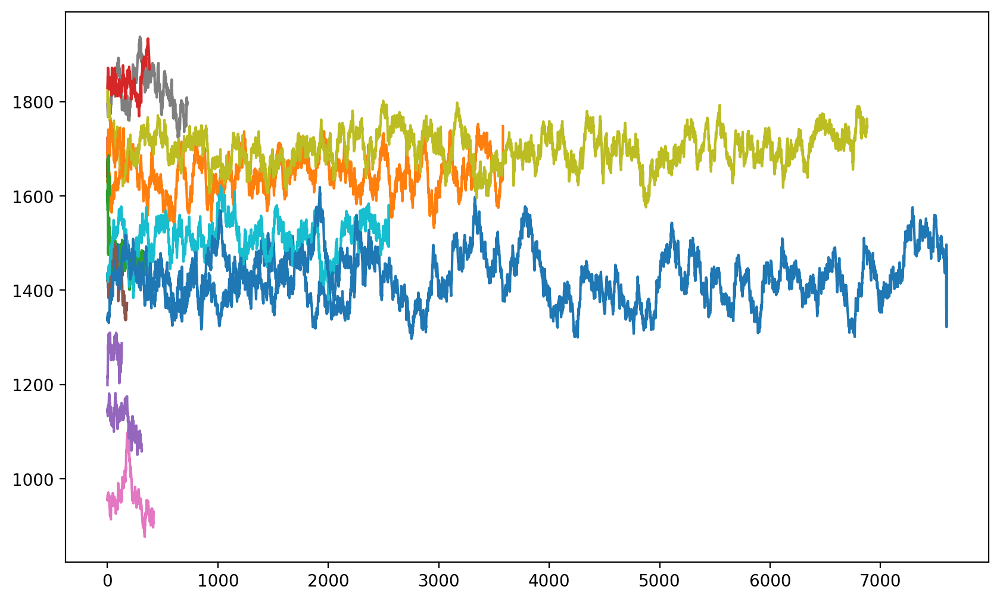

In [86]:
plot_group(labels_x_mm,X_samples2,16)

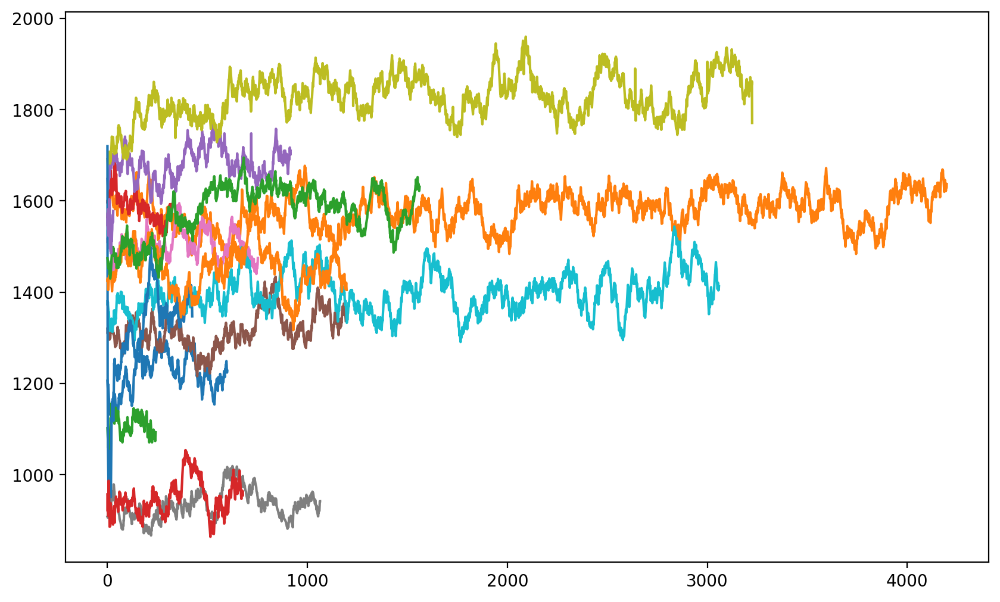

In [87]:
plot_group(labels_x_mm,X_samples2,17)

In [89]:
samples

,Player,0,1,2,3,4,5,6,7,8,...,21501,21502,21503,21504,21505,21506,21507,21508,EuclidanClusterSSID,EuclidanClusterMMID
5,ABCi,1495,1486.0,1502.0,1493.0,1490.0,1475.0,1474.0,1461.0,1450.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,13,0
8,ABSBEGINNER,1398,1409.0,1398.0,1409.0,1400.0,1405.0,1415.0,1422.0,1416.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,10,7
15,ADJUSTOR,1845,1839.0,1850.0,1844.0,1841.0,1838.0,1830.0,1840.0,1835.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,11
17,AFCERGY,1621,1626.0,1615.0,1605.0,1594.0,1584.0,1590.0,1596.0,1601.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,17,3
18,AFRF,1367,1361.0,1372.0,1381.0,1379.0,1375.0,1368.0,1375.0,1368.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,9,14
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
21085,zwartspeler,1843,1850.0,1854.0,1861.0,1865.0,1870.0,1875.0,1879.0,1883.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,11,8
21089,zwirek,994,985.0,951.0,1007.0,983.0,963.0,1016.0,994.0,1081.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,15,11
21090,zxtxf,1408,1381.0,1330.0,1326.0,1312.0,1329.0,1288.0,1265.0,1252.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,9,12
21092,zyrq,1449,1457.0,1465.0,1457.0,1466.0,1474.0,1479.0,1469.0,1460.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1,1


In [22]:
samples.to_csv(f"{PROJECT_PATH}/data/fics/interim/chess-games-clean-blitz-rated-vfinal-players-interval-90-euclidan-cluster-samples.csv")

In [31]:
samples=pd.read_csv(f"{PROJECT_PATH}/data/fics/interim/chess-games-clean-blitz-rated-vfinal-players-interval-90-euclidan-cluster-samples.csv")

We can clearly see trends in the cluster

* Cluster 1 represents players with stable improvment pattern
* Cluster 2 represents players with decreasing  improvment pattern
* Cluster 3 represents players with increasing  improvment pattern 
* Cluster 4 represents players with increasing  improvment pattern
* Cluster 5 represents players with decreasing  improvment pattern
* Cluster 6 represents players with decreasing  improvment pattern
* Cluster 7 represents players with decreasing  improvment pattern
* Cluster 8 represents players with stable  improvment pattern
* Cluster 9 represents players with stable  improvment pattern
* Cluster 10 represents players with stable  improvment pattern
* Cluster 11 represents players with stable  improvment pattern
* Cluster 12 represents players with decreasing  improvment pattern
* Cluster 13 represents players with decreasing  improvment pattern
* Cluster 14 represents players with stable  improvment pattern
* Cluster 15 represents players with stable  improvment pattern
* Cluster 16 represents players with increasing  improvment pattern
* Cluster 17 represents players with increasing  improvment pattern
* Cluster 18 represents players with stable  improvment pattern


####  Cluster EDA

In [15]:
clusters_df=pd.DataFrame.from_dict({})

In [16]:
players_per_cluster={}
for cluster_id in set(samples["EuclidanClusterSSID"]):
    players_per_cluster[cluster_id]=set(samples[samples["EuclidanClusterSSID"]==cluster_id]["Player"])


In [97]:
# import pickle
# with open(f"{PROJECT_PATH}/data/fics/proccessed/players_per_cluster.pkl", 'wb') as f:
#     pickle.dump(players_per_cluster, f)
# clusters_df["Player"]=samples["Player"]
# clusters_df["EuclidanClusterSSID"]=samples["EuclidanClusterSSID"]
# clusters_df["EuclidanClusterMMID"]=samples["EuclidanClusterMMID"]

In [17]:
df_groups_per_cluster={i:df_2018[df_2018["Player"].isin(players_per_cluster[i])] for i in players_per_cluster.keys() }

In [14]:
from scipy.stats import skew
from tsfresh.feature_extraction.feature_calculators import mean_abs_change
from scipy.stats import shapiro


def get_df(df):
    df_dt=df.copy()

    for i in range(1,len(df_dt.columns)):
        df_dt[i]=df[i]-df[i-1]

    df_dt[0]=df[0]-df[0]
    return df_dt


def find_features(df,features):
    df_dt=get_df(df)

    feature_values=[[] for i in range(len(features))]


    for p in df.index:
        c=list(df[df.index==p].values)[0]
        for i in range(len(features)):
            feature_values[i].append(features[i]["func"](c))

    for i in range(len(features)):
        
        if (shapiro(feature_values[i]).pvalue)< 0.1:
            print(shapiro(feature_values[i]).pvalue)
            df_dt[features[i]["name"]]=feature_values[i]

    return df_dt


In [102]:
df_groups_per_cluster[0]

,Unnamed: 0,Result,FICSGamesDBGameNo,Player,Elo,Opponent,OpponentElo,Date,Time,Year,Month,Day,Hour,Minute,Second
17740,18981,Lost,450866229,DixierRebel,1504,henkdedenktenk,1487,2018.11.20,07:52:00,2018,11,20,7,52,0
17756,18997,Won,450866210,DixierRebel,1542,WASFOX,1542,2018.11.10,15:59:00,2018,11,10,15,59,0
56962,61477,Lost,452474071,bipedo,1566,fajchess,1492,2018.10.30,14:03:00,2018,10,30,14,3,0
191591,208382,Won,450799896,TerminatorII,1670,icemaniran,1776,2018.12.04,00:30:00,2018,12,4,0,30,0
227589,246767,Lost,450247946,nikf,1503,atez,1302,2018.05.25,14:33:00,2018,5,25,14,33,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
27723412,14408008,Lost,434845532,Akius,1418,PerFavore,1358,2018.08.09,12:17:00,2018,8,9,12,17,0
27723435,14408035,Won,434845498,LevelUp,1491,mexicanstyle,1411,2018.08.09,12:11:00,2018,8,9,12,11,0
27723437,14408037,Won,434845494,MisterLister,1282,Freddie,1342,2018.08.09,12:16:00,2018,8,9,12,16,0
27723445,14408045,Won,434845484,benzebest,1382,EagleWingz,1306,2018.08.09,12:15:00,2018,8,9,12,15,0


In [12]:
from  tsfresh.feature_extraction.feature_calculators import kurtosis

def get_win_vs_color_df(df):
    result={
        "Name":[],
        "Count":[],
        "Percent":[],
    }

    freq=Counter(df["Result"])
    total=sum(list(freq.values()))
    result["Name"].append("Won")
    result["Count"].append(freq["Won"])
    result["Percent"].append((freq["Won"]/total)*100)
    result["Name"].append("Lost")
    result["Count"].append(freq["Lost"])
    result["Percent"].append((freq["Lost"]/total)*100)
    result["Name"].append("Tie")
    result["Count"].append(freq["Tie"])
    result["Percent"].append((freq["Tie"]/total)*100)
    return pd.DataFrame.from_dict(result)


def get_players_df(df):
    result={
        "Name":[],
        "Count":[],
        "Percent":[],
        "EloMean":[],
        "EloVar":[],
        "EloMin":[],
        "EloMax":[],
        "EloSkew":[],
        "OpponentEloMean":[],
        "OpponentEloVar":[],
        "EloDiffMean":[],
        "EloDiffVar":[],
        "EloDiffSkew":[],
    }
    freq=Counter(df["Player"])
    total=sum(list(freq.values()))
    for player in freq:
        result["Name"].append(player)
        result["Count"].append(freq[player])
        result["Percent"].append((freq[player]/total)*100)
        result["EloMean"].append(np.mean(df[df["Player"]==player]["Elo"]))
        result["EloVar"].append(np.var(df[df["Player"]==player]["Elo"]))
        result["EloMin"].append(min(df[df["Player"]==player]["Elo"]))
        result["EloMax"].append(max(df[df["Player"]==player]["Elo"]))
        result["EloSkew"].append(skew(df[df["Player"]==player]["Elo"]))
        result["OpponentEloMean"].append(np.mean(df[df["Player"]==player]["OpponentElo"]))
        result["OpponentEloVar"].append(np.mean(df[df["Player"]==player]["OpponentElo"]))
        result["EloDiffMean"].append(np.mean(df[df["Player"]==player]["Elo"]-df[df["Player"]==player]["OpponentElo"]))
        result["EloDiffVar"].append(np.var(df[df["Player"]==player]["Elo"]-df[df["Player"]==player]["OpponentElo"]))
        result["EloDiffSkew"].append(skew(df[df["Player"]==player]["Elo"]-df[df["Player"]==player]["OpponentElo"]))

    res_df=pd.DataFrame.from_dict(result).sort_values(by="Count",ascending=False).reset_index()
    res_df=res_df[res_df.index<10]
    return res_df.drop(columns="index")

def get_general_info(df):
    result={
        "Name":[],
        "Value":[],
    }

    result["Name"].append("EloMean")
    result["Value"].append(np.mean(df["Elo"]))
    result["Name"].append("EloVar")
    result["Value"].append(np.var(df["Elo"]))
    result["Name"].append("EloSkew")
    result["Value"].append(skew(df["Elo"]))
    result["Name"].append("EloMin")
    result["Value"].append(min(df["Elo"]))
    result["Name"].append("EloMax")
    result["Value"].append(max(df["Elo"]))
    result["Name"].append("EloDiffMean")
    result["Value"].append(np.mean(df["Elo"]-df["OpponentElo"]))
    result["Name"].append("EloDiffVar")
    result["Value"].append(np.var(df["Elo"]-df["OpponentElo"]))
    result["Name"].append("EloDiffSkew")
    result["Value"].append(skew(df["Elo"]-df["OpponentElo"]))
    result["Name"].append("EloDiffKurtosis")
    result["Value"].append(kurtosis(df["Elo"]-df["OpponentElo"]))
    result["Name"].append("NumberOfPlayers")
    result["Value"].append(len(set(df["Player"])))
    result["Name"].append("NumberOfOpponents")
    result["Value"].append(len(set(df["Opponent"])))
    result["Name"].append("TotalWon")
    result["Value"].append(Counter(df["Result"])["Won"])
    result["Name"].append("TotalLost")
    result["Value"].append(Counter(df["Result"])["Lost"])
    result["Name"].append("TotalTie")
    result["Value"].append(Counter(df["Result"])["Tie"])

    res_df= pd.DataFrame.from_dict(result).T
    res_df.columns=[v for v in res_df[res_df.index=="Name"].values]
    return res_df[res_df.index=="Value"]


In [18]:
for k,v in df_groups_per_cluster.items():
    print("-"*50,k,"-"*50)
    display(get_players_df(v))

-------------------------------------------------- 0 --------------------------------------------------


KeyboardInterrupt: 

In [19]:
frames=[]
for k,v in df_groups_per_cluster.items():
    frame=get_general_info(v)
    frame.index=[k]
    frames.append(frame)
    
display(pd.concat(frames))

,EloMean,EloVar,EloSkew,EloMin,EloMax,EloDiffMean,EloDiffVar,EloDiffSkew,EloDiffKurtosis,NumberOfPlayers,NumberOfOpponents,TotalWon,TotalLost,TotalTie
0,1537.575259,60644.866319,0.121646,790.0,2185.0,4.771914,31827.659705,0.184971,5.918898,339.0,11984.0,274908.0,279741.0,21142.0
1,1496.751496,36853.18786,0.132339,759.0,2440.0,-11.781587,27179.893376,-0.518528,5.532715,387.0,11114.0,228885.0,216462.0,18472.0
2,1524.396686,47411.204683,0.480733,606.0,2826.0,-9.438696,25381.265532,-0.386091,3.701234,429.0,11843.0,316860.0,306679.0,24783.0
3,1549.167685,52866.638131,0.444205,631.0,2719.0,3.311465,27958.695792,0.806851,11.746429,324.0,11462.0,269769.0,273040.0,22125.0
4,1513.152529,51066.445981,0.313957,731.0,2676.0,-2.740379,24016.186733,-0.221866,4.390336,265.0,11286.0,214707.0,211633.0,16383.0
5,1562.063237,57897.712627,1.056954,890.0,2811.0,23.673044,44390.631959,1.888516,10.841054,272.0,11536.0,220321.0,234001.0,18837.0
6,1528.52813,62354.428074,0.428141,819.0,2492.0,0.405992,36310.809738,1.155583,9.585694,322.0,11450.0,227230.0,221219.0,16851.0
7,1540.542278,41553.87913,0.310652,676.0,3020.0,-1.516761,23619.176129,-0.593442,4.483495,276.0,10488.0,224173.0,225264.0,18967.0
8,1548.467982,51656.542455,0.992358,749.0,3007.0,3.338107,29444.703542,1.554439,18.326794,349.0,11757.0,283127.0,285520.0,21805.0
9,1552.283759,44558.093908,0.126137,841.0,2238.0,-4.935639,30297.333913,-0.455855,4.067038,319.0,12007.0,298894.0,294929.0,25043.0


In [4]:
extra_df=pd.read_csv(f"{PROJECT_PATH}/data/fics/interim/chess-games-clean-blitz-rated-vfinal-details.csv")

In [24]:
FICSGamesDBGameNo=[]
for v in df_groups_per_cluster.values():
    FICSGamesDBGameNo=FICSGamesDBGameNo+list(v["FICSGamesDBGameNo"])

In [27]:
extra_df=extra_df[extra_df["FICSGamesDBGameNo"].isin(FICSGamesDBGameNo)]

In [28]:
extra_df.to_csv(f"{PROJECT_PATH}/data/fics/interim/chess-games-clean-blitz-rated-vfinal-details-filtered.csv")

In [40]:
def get_month_info(df):
    result={
        "Month":[],
        "Value":[],
        "Percentage":[],
    }

    freq=dict(Counter(df["Month"]))
    total=sum(freq.values())
    for k,v in freq.items():
        result["Month"].append(k)
        result["Value"].append(v)
        result["Percentage"].append((v/total)*100)

    return pd.DataFrame.from_dict(result).sort_values(by="Value")


In [41]:
for i in range(18):
    display(get_month_info(df_groups_per_cluster[i]))

,Month,Value,Percentage
1,10,45159,7.842950
0,11,45751,7.945765
4,9,45796,7.953580
5,6,46221,8.027392
2,12,46616,8.095993
9,2,47007,8.163900
3,5,48320,8.391934
7,7,48774,8.470782
10,4,48928,8.497528
6,8,49022,8.513853


,Month,Value,Percentage
3,11,33702,7.266197
7,6,34139,7.360414
1,12,36102,7.783640
6,7,36395,7.846811
11,5,37376,8.058316
2,10,37439,8.071899
0,8,37620,8.110923
9,9,39585,8.534579
4,4,40711,8.777346
10,2,41394,8.924602


,Month,Value,Percentage
3,12,48614,7.498434
6,11,49338,7.610107
7,10,50499,7.789185
0,8,52762,8.138240
1,6,53061,8.184359
2,9,53518,8.254849
8,4,53944,8.320557
11,2,55613,8.577991
5,7,56158,8.662054
9,1,57578,8.881081


,Month,Value,Percentage
5,6,42658,7.550971
11,1,43541,7.707272
4,2,43753,7.744799
9,4,45303,8.019167
10,9,46610,8.250521
6,11,46924,8.306103
3,7,47178,8.351064
2,5,47701,8.443641
1,10,49013,8.675881
8,8,49730,8.802798


,Month,Value,Percentage
0,11,32869,7.424281
4,12,33655,7.601819
2,10,35229,7.957346
9,2,35283,7.969543
8,9,35844,8.096259
5,8,37254,8.414742
3,7,37570,8.486119
11,5,37849,8.549138
6,3,38038,8.591828
1,6,38751,8.752877


,Month,Value,Percentage
0,10,36038,7.616467
3,12,37033,7.826756
7,8,37553,7.936656
4,11,37977,8.026266
9,2,38805,8.201260
2,9,39003,8.243106
10,6,39220,8.288968
8,7,39752,8.401404
1,1,41154,8.697710
6,4,41173,8.701726


,Month,Value,Percentage
2,12,36587,7.863099
11,2,36848,7.919192
4,6,37079,7.968837
0,7,37737,8.110251
5,4,38019,8.170858
3,11,38708,8.318934
8,8,39234,8.431979
10,3,39704,8.532989
7,10,39934,8.582420
6,9,40083,8.614442


,Month,Value,Percentage
6,4,35711,7.623974
10,2,35893,7.662830
5,6,37839,8.078283
7,8,38437,8.205950
1,7,38446,8.207872
2,9,38808,8.285156
4,10,38810,8.285583
3,12,39620,8.458510
0,11,40455,8.636775
8,3,40950,8.742453


,Month,Value,Percentage
2,11,44357,7.512380
0,12,45801,7.756939
1,10,46159,7.817570
3,9,47119,7.980158
5,8,48052,8.138172
11,2,48678,8.244193
4,6,49886,8.448782
8,5,51380,8.701808
6,4,51485,8.719591
9,7,51491,8.720607


,Month,Value,Percentage
6,12,47619,7.694557
0,7,48440,7.827219
9,6,49259,7.959558
3,2,50628,8.180769
1,3,50973,8.236516
8,4,51127,8.261401
5,9,51835,8.375803
4,11,52121,8.422017
7,8,52157,8.427834
11,1,53540,8.651307


,Month,Value,Percentage
5,9,40495,7.388668
3,8,41624,7.594664
4,11,42417,7.739354
0,10,43415,7.921448
9,7,43431,7.924367
2,6,45679,8.334535
1,12,45711,8.340373
11,2,46504,8.485063
7,4,47208,8.613514
8,3,49194,8.975877


,Month,Value,Percentage
5,6,27358,7.237834
1,10,29297,7.750816
7,9,29457,7.793146
3,7,29502,7.805051
2,11,29520,7.809813
0,12,29677,7.851349
4,8,30955,8.189457
11,2,31765,8.403750
10,4,33430,8.844243
8,5,34860,9.222564


,Month,Value,Percentage
2,6,32831,7.516358
1,12,33948,7.772085
3,9,34516,7.902123
5,11,35253,8.070853
7,7,35361,8.095578
6,10,35598,8.149837
0,8,35892,8.217146
10,4,36607,8.380839
4,5,36641,8.388623
11,2,37901,8.677088


,Month,Value,Percentage
9,2,36303,7.651839
8,10,36372,7.666382
5,11,37362,7.875051
0,12,37878,7.983812
7,9,38565,8.128616
4,8,39350,8.294076
1,6,39689,8.365530
10,1,39750,8.378387
2,7,40491,8.534573
11,4,41804,8.811323


,Month,Value,Percentage
3,11,43227,7.371351
2,12,45704,7.793745
6,2,46563,7.940227
4,10,47318,8.068975
1,8,48802,8.322036
8,7,48904,8.339430
5,9,49188,8.387859
9,1,49451,8.432708
0,6,50169,8.555146
10,4,50203,8.560944


,Month,Value,Percentage
11,2,57296,7.878652
6,11,57385,7.890890
0,10,58153,7.996496
1,12,58357,8.024548
3,6,58570,8.053837
8,4,60413,8.307264
9,1,60726,8.350304
4,9,61498,8.456460
2,5,62423,8.583655
7,7,62617,8.610332


,Month,Value,Percentage
2,6,41858,7.339594
8,9,44856,7.865279
10,7,45128,7.912973
4,4,45233,7.931384
5,2,46014,8.068328
9,8,47044,8.248934
6,10,48105,8.434975
7,5,48138,8.440761
0,11,48697,8.538779
1,12,49101,8.609619


,Month,Value,Percentage
10,9,40336,7.725442
11,6,40753,7.805309
1,7,41129,7.877323
8,8,41746,7.995495
2,11,41930,8.030736
4,12,42622,8.163273
7,2,43157,8.265740
0,10,43811,8.390999
3,4,44862,8.592294
9,1,46236,8.855452


In [46]:
extra_df.columns

Index(['Unnamed: 0.1', 'Unnamed: 0', 'FICSGamesDBGameNo', 'White', 'Black',
       'WhiteElo', 'BlackElo', 'WhiteRD', 'BlackRD', 'TimeControl', 'Date',
       'Time', 'WhiteClock', 'BlackClock', 'ECO', 'PlyCount', 'Result', 'Move',
       'Year', 'EloDiff', 'RelativeEloDiff', 'ECO_class', 'Winning status'],
      dtype='object')

In [ ]:
all_ids=[]
for i in tqdm(range(len(df_groups_per_cluster))):
        all_ids=all_ids+list(df_groups_per_cluster[i]["FICSGamesDBGameNo"])




In [5]:
import pickle
with open(f"{PROJECT_PATH}/data/fics/proccessed/df_groups_per_cluster.pkl", 'rb') as f:
    df_groups_per_cluster=pickle.load(f)

In [144]:
def get_interval(year,interval):
    start_date = pd.to_datetime([f'{year}-01-01 00:00:00']).min()
    end_date = pd.to_datetime([f'{year+1}-01-01 00:00:00']).min()
    interval_dates=[start_date]
    curr = start_date + pd.Timedelta(days=interval)
    while curr<end_date:
        interval_dates.append(curr)
        curr=curr+pd.Timedelta(days=interval)
    return interval_dates+[end_date]

In [14]:
interval_dates=get_interval(2018,90)
interval_dates

[Timestamp('2018-01-01 00:00:00'),
 Timestamp('2018-04-01 00:00:00'),
 Timestamp('2018-06-30 00:00:00'),
 Timestamp('2018-09-28 00:00:00'),
 Timestamp('2018-12-27 00:00:00'),
 Timestamp('2019-01-01 00:00:00')]

In [15]:
def get_row(idx:int):
    return groups[idx]

In [ ]:
for i in tqdm(range(len(df_groups_per_cluster))):
    df_groups_per_cluster[i]=df_groups_per_cluster[i].sort_values("FICSGamesDBGameNo")

    curr_cluster=df_groups_per_cluster[i]
    rows=curr_cluster["FICSGamesDBGameNo"].apply(lambda idx:get_row(idx))
    
    curr_cluster["ECO"]=rows["ECO"]
    curr_cluster["PlyCount"]=rows["PlyCount"]
    curr_cluster["Result"]=rows["Result"]
    curr_cluster["Winning status"]=rows["Winning status"]
    curr_cluster["ECO_class"]=rows["ECO_class"]
    curr_cluster["Move"]=rows["Move"]
    curr_cluster["White"]=rows["White"]
    df_groups_per_cluster[i]=curr_cluster

### 2.3 Clustering using dtw

In [10]:
wcss_score_dtw_x_ss,calinski_harabasz_dtw_score_x_ss=kmeans_pipeline(X_ss,"dtw",max_k=10)
wcss_score_dtw_x_mm,calinski_harabasz_dtw_score_x_mm=kmeans_pipeline(X_mm,"dtw",max_k=10)

1.8678508476509754 2624.122200104667
K = 2. Took 35.55 seconds to calculate.
1.4383554186075374 2233.303933694409
K = 3. Took 101.72 seconds to calculate.
1.0922136182022812 2094.191210477203
K = 4. Took 78.44 seconds to calculate.
0.9222091445221582 1850.4251239813111
K = 5. Took 134.03 seconds to calculate.
0.7815392573876038 1636.8615463001001
K = 6. Took 347.40 seconds to calculate.
0.7135115508922621 1467.1493588987455
K = 7. Took 445.56 seconds to calculate.
0.6860780144770853 1593.3927782980622
K = 8. Took 508.74 seconds to calculate.
0.6365137919474032 1379.2608490055825
K = 9. Took 601.63 seconds to calculate.
0.5994337464936531 1315.1148535721948
K = 10. Took 790.88 seconds to calculate.
0.2558857550106936 2435.4399610466944
K = 2. Took 86.28 seconds to calculate.
0.19528387816038473 1959.1211003675871
K = 3. Took 79.90 seconds to calculate.
0.1383134058650927 1858.303122868651
K = 4. Took 124.21 seconds to calculate.
0.12393845188475171 1444.444384464475
K = 5. Took 153.86 s

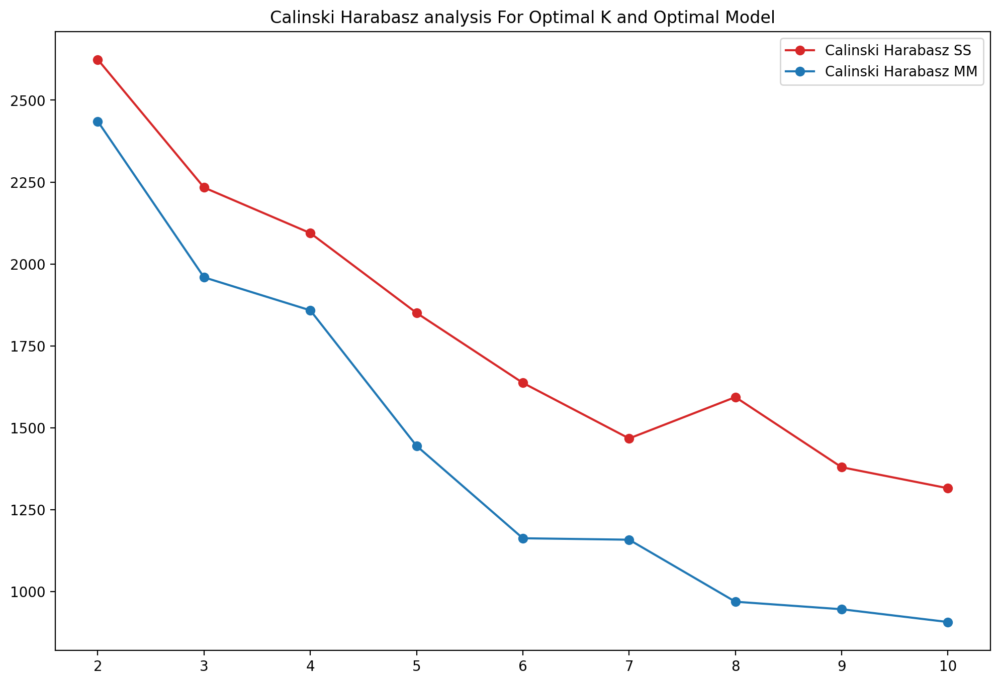

In [16]:
plt.figure(figsize=(12, 8))
plt.plot(range(2, 10+1), calinski_harabasz_dtw_score_x_ss, "-o", c="C3")
plt.plot(range(2, 10+1), calinski_harabasz_dtw_score_x_mm, "-o", c="C0")
plt.title("Calinski Harabasz analysis For Optimal K and Optimal Model")
plt.legend(["Calinski Harabasz SS", "Calinski Harabasz MM"]);

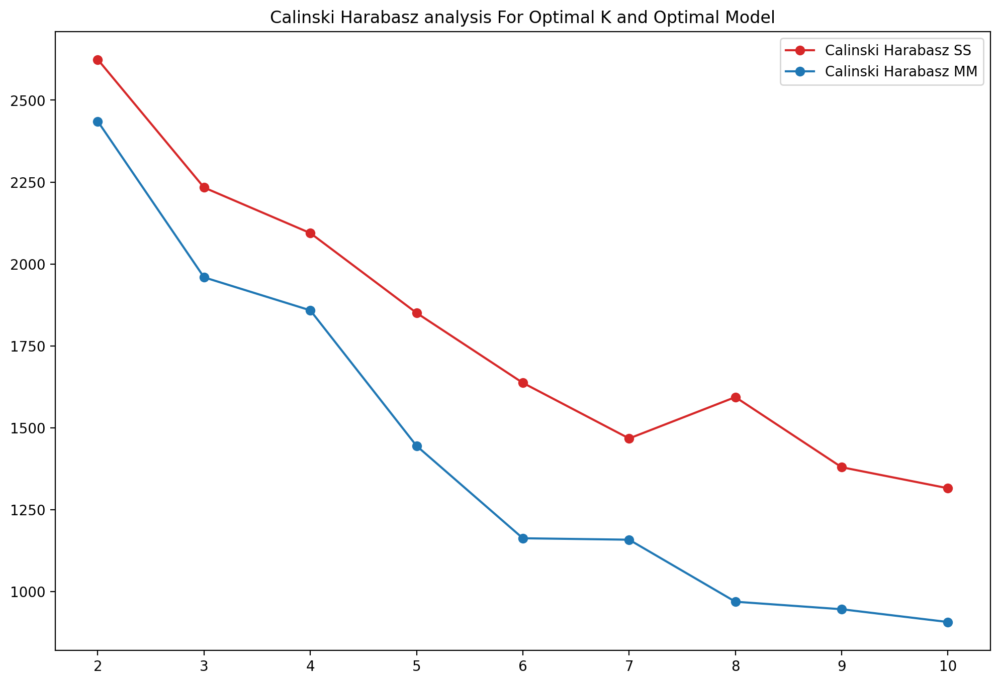

In [17]:
plt.figure(figsize=(12, 8))
plt.plot(range(2, 10+1), calinski_harabasz_dtw_score_x_ss, "-o", c="C3")
plt.plot(range(2, 10+1), calinski_harabasz_dtw_score_x_mm, "-o", c="C0")
plt.title("Calinski Harabasz analysis For Optimal K and Optimal Model")
plt.legend(["Calinski Harabasz SS", "Calinski Harabasz MM"]);

In [19]:
def get_best_calinski_harabasz(results):
    index=0
    for i in range(len(results)):
        if results[i]>results[index]:
            index=i
    return i  


In [20]:

print("The best for the case of ss:",get_best_calinski_harabasz(calinski_harabasz_dtw_score_x_ss))
print("The best for the case of mm:",get_best_calinski_harabasz(calinski_harabasz_dtw_score_x_mm))

The best for the case of ss: 8
The best for the case of mm: 8


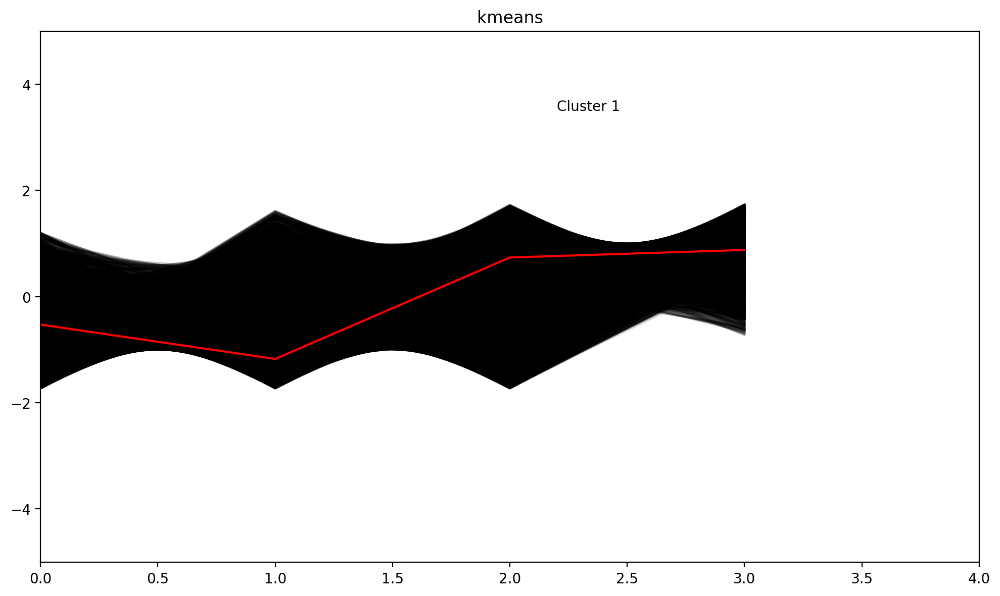

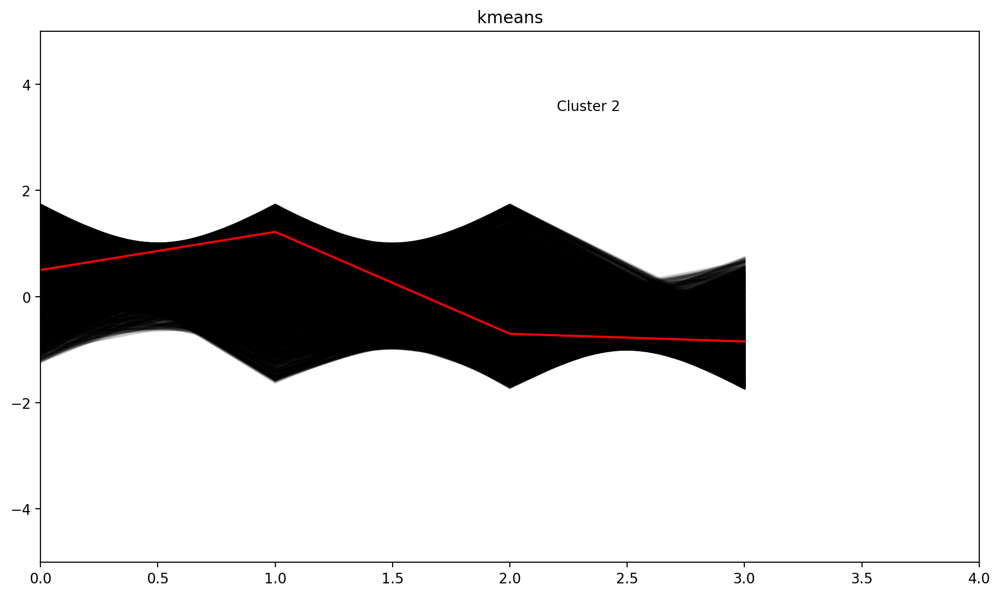

The 55.54% of the observations fall into Cluster 1
The 44.46% of the observations fall into Cluster 2


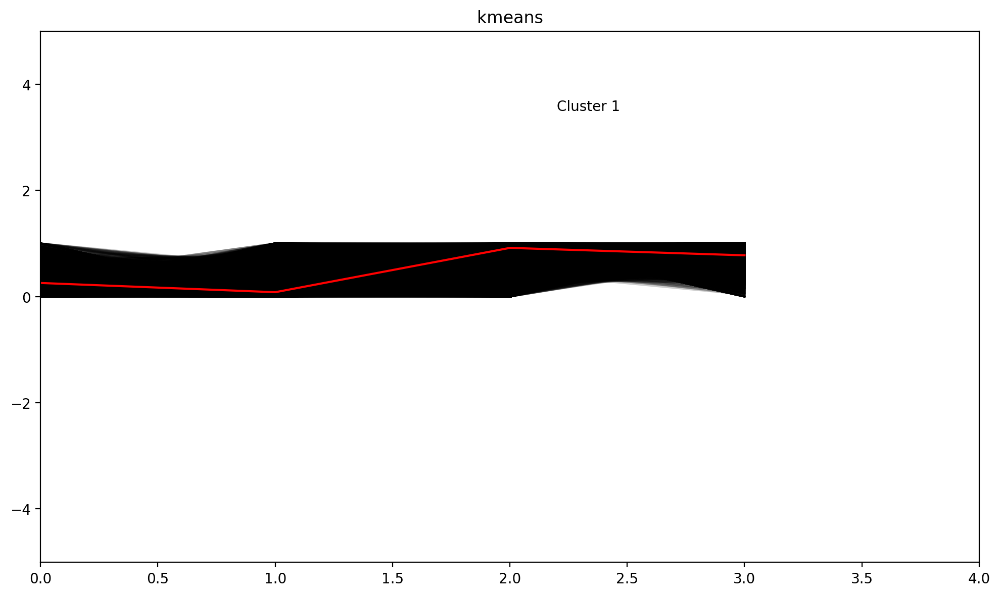

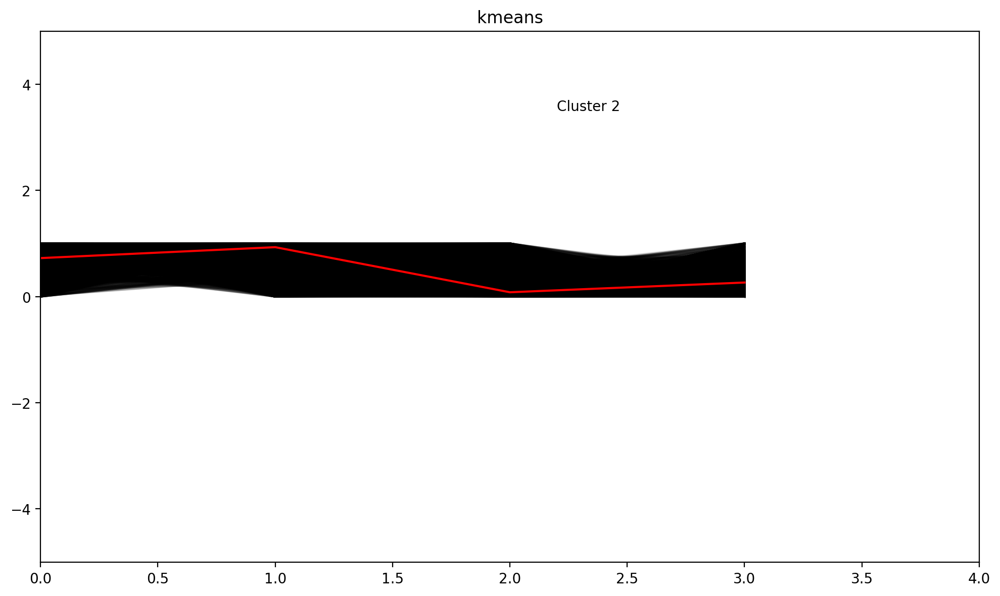

The 54.09% of the observations fall into Cluster 1
The 45.91% of the observations fall into Cluster 2


In [23]:
labels_x_ss=kmeans_cluster(2, "dtw-ss",X_ss,"dtw")
labels_x_mm=kmeans_cluster(2, "dtw-mm",X_mm,"dtw")

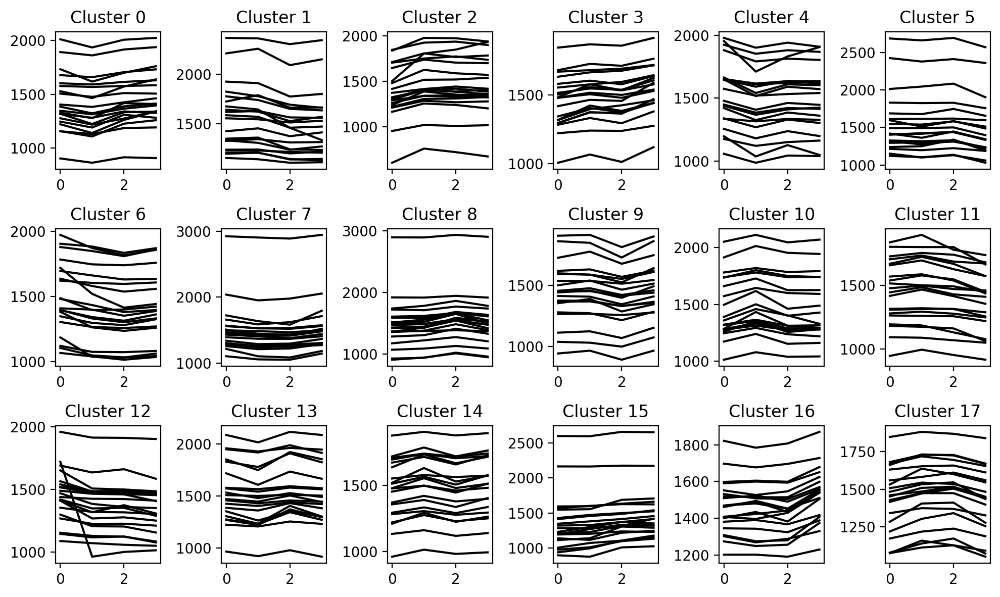

In [13]:
groups=zip(labels_x_ss,X)
my_d_ss={}
for l,s in groups:
    my_d_ss[l]=my_d_ss.get(l,[])
    my_d_ss[l].append(s)
plot_cluster(my_d_ss)

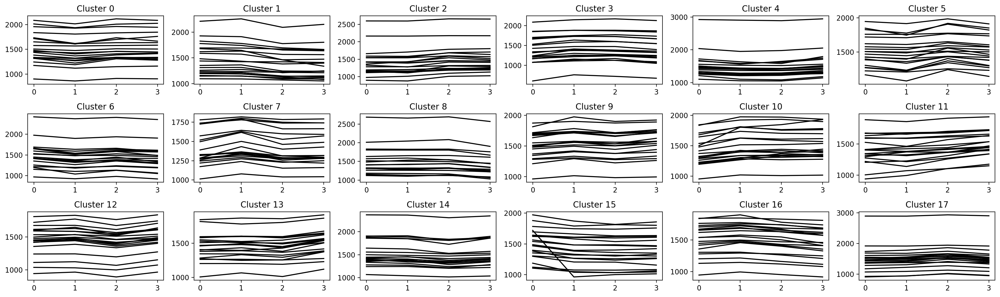

In [139]:
groups=zip(labels_x_mm,X)
my_d_mm={}
for l,s in groups:
    my_d_mm[l]=my_d_mm.get(l,[])
    my_d_mm[l].append(s)
    
plot_cluster(my_d_mm)

In [15]:
df_interval_2018["DTWClusterSSID"]=labels_x_ss
df_interval_2018["DTWClusterMMID"]=labels_x_mm

In [140]:
X_samples = to_time_series_dataset(samples.drop(columns="Player").values)
X_samples2=[]
for i in range(len(X_samples)):
    curr=X_samples[i][X_samples[i]>0]
    curr=curr[:-1]
    curr=curr[:-1]
    while True:
        if curr[-1]!=0:
            break
        curr=curr[:-1]
    X_samples2.append(curr)


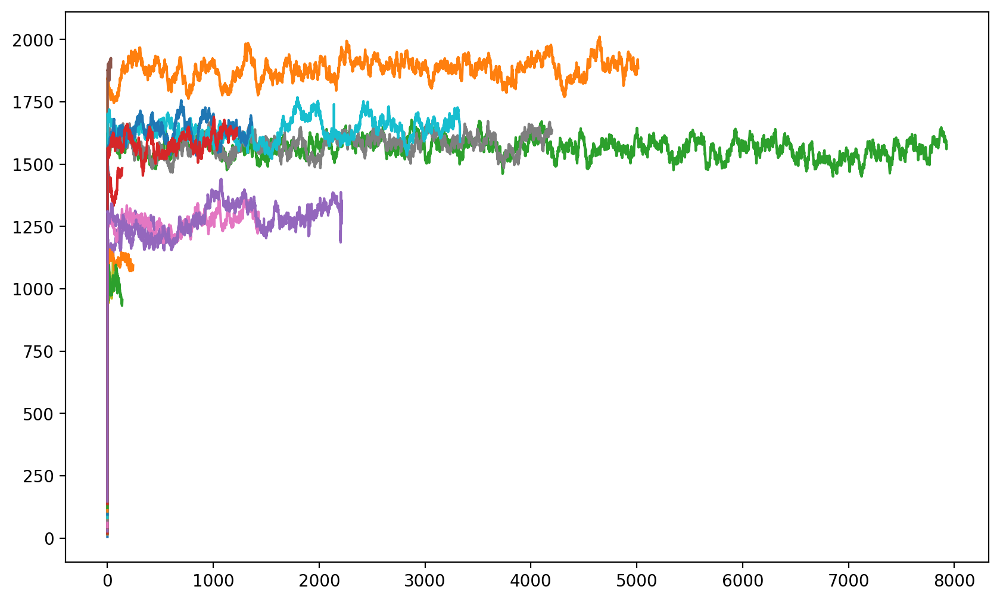

In [33]:
plot_group(labels_x_mm,X_samples2,0)


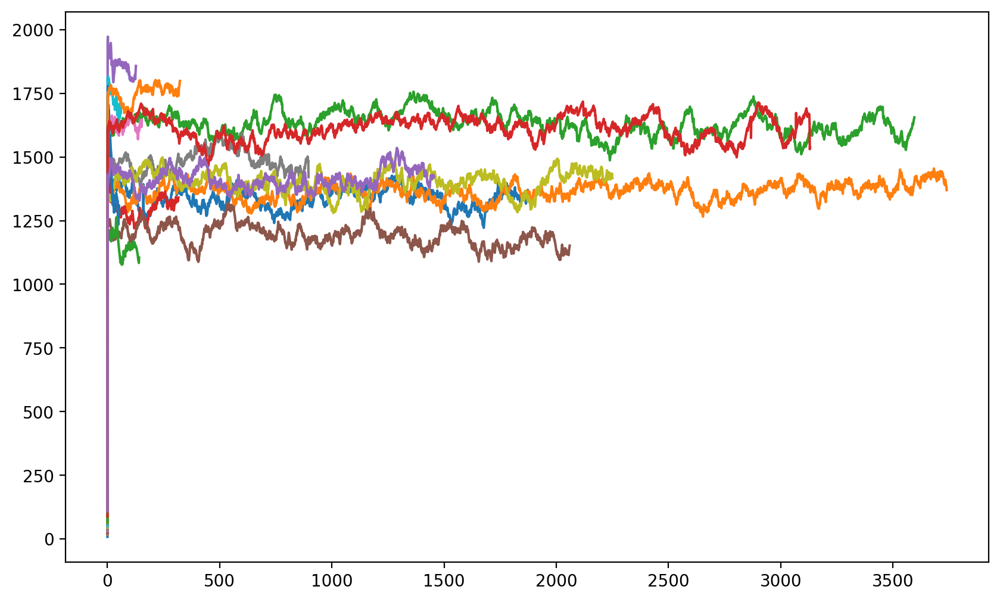

In [34]:
plot_group(labels_x_mm,X_samples2,1)


In [35]:
samples.to_csv(f"{PROJECT_PATH}/data/fics/interim/chess-games-clean-blitz-rated-vfinal-players-interval-90-dtw-cluster-samples.csv")

* as can be seen the dtw is not a suitble metric
* this can be asssummed to occur becuase of the downsampling causing the data to become simplir and so in this case euclidan distance game the only good results

In [142]:
my_d_mm[0]

[array([[1458.],
        [1429.],
        [1457.],
        [1445.]]),
 array([[1651.],
        [1615.],
        [1634.],
        [1635.]]),
 array([[1438.],
        [1367.],
        [1410.],
        [1424.]]),
 array([[1245.],
        [1190.],
        [1309.],
        [1281.]]),
 array([[1577.],
        [1568.],
        [1577.],
        [1584.]]),
 array([[2085.],
        [2014.],
        [2115.],
        [2085.]]),
 array([[1384.],
        [1322.],
        [1387.],
        [1413.]]),
 array([[1318.],
        [1223.],
        [1333.],
        [1338.]]),
 array([[1506.],
        [1476.],
        [1511.],
        [1506.]]),
 array([[1338.],
        [1268.],
        [1329.],
        [1302.]]),
 array([[2012.],
        [1936.],
        [2008.],
        [2025.]]),
 array([[902.],
        [862.],
        [913.],
        [905.]]),
 array([[1957.],
        [1927.],
        [1961.],
        [1945.]]),
 array([[1175.],
        [1120.],
        [1150.],
        [1162.]]),
 array([[1478.],
       

### 2.4 repeat clustering with other length

lets see what are the possible datasetlengths

In [5]:
for y in [2018,2019,2020]:
    for d in [30,45,90]:
        optional_intervals=get_samples_interval(player_df[player_df["Year"]==y],90)
        print(y,d,len(optional_intervals))

2018 30 5999
2018 45 5999
2018 90 5999
2019 30 4755
2019 45 4755
2019 90 4755
2020 30 3481
2020 45 3481
2020 90 3481


#### 2.4.1  repeat on length 30

In [7]:
def get_samples_interval_year(player_df,year,days):
    return get_samples_interval(player_df[player_df["Year"]==year],days)

def get_interval_normalized(df_interval):
    # Standardizing (z-score normalization) a dataset involves rescaling the distribution of values
    ss = StandardScaler()

    scaled_ss = ss.fit_transform(df_interval.T)
    df_ss = pd.DataFrame(scaled_ss.T, columns=df_interval.columns, index=df_interval.index)
    X_ss = df_ss.values
    display(df_ss.head())

    # Normalization
    mm = MinMaxScaler()
    scaled_mm = mm.fit_transform(df_interval.T)
    df_mm = pd.DataFrame(scaled_mm.T, columns=df_interval.columns, index=df_interval.index)
    X_mm = df_mm.values
    display(df_mm.head())


    # convert dataframe to time_series_dataset
    X = to_time_series_dataset(df_interval.values)

    # normalize time series to zero mean and unit variance
    X_train = TimeSeriesScalerMeanVariance().fit_transform(X)
    return X_ss,X_mm,X,X_train


load data 

In [12]:
df_interval=get_samples_interval_year(player_df,2018,30)
X_ss,X_mm,X,X_train=get_interval_normalized(df_interval)

,0,1,2,3,4,5,6,7,8,9,10
ABSBEGINNER,0.366674,1.448096,-0.364017,0.717405,-1.942309,0.775861,0.717405,0.074398,-1.182390,-1.211618,0.600495
ADJUSTOR,-1.952678,-0.073225,-0.571856,0.003487,-1.262267,0.387049,0.195268,1.921296,0.847323,0.770610,-0.265006
AFCERGY,-0.941452,-0.257806,-1.144014,0.476481,1.717172,-0.080564,0.451160,1.261408,0.780323,-1.675739,-0.586969
AFRF,0.172023,-0.917457,-1.060810,1.634221,1.146821,-0.430058,1.118151,-0.344046,-1.777573,0.544740,-0.086012
AHund,-0.490041,-0.316155,1.944355,-0.142270,0.785119,1.306775,0.263463,-1.910105,-0.258194,-0.750869,-0.432079


,0,1,2,3,4,5,6,7,8,9,10
ABSBEGINNER,0.681034,1.000000,0.465517,0.784483,0.000000,0.801724,0.784483,0.594828,0.224138,0.215517,0.750000
ADJUSTOR,0.000000,0.485149,0.356436,0.504950,0.178218,0.603960,0.554455,1.000000,0.722772,0.702970,0.435644
AFCERGY,0.216418,0.417910,0.156716,0.634328,1.000000,0.470149,0.626866,0.865672,0.723881,0.000000,0.320896
AFRF,0.571429,0.252101,0.210084,1.000000,0.857143,0.394958,0.848739,0.420168,0.000000,0.680672,0.495798
AHund,0.368421,0.413534,1.000000,0.458647,0.699248,0.834586,0.563910,0.000000,0.428571,0.300752,0.383459


find best k

In [13]:
wcss_score_euclidean_x_ss,calinski_harabasz_euclidean_score_x_ss=kmeans_pipeline(X_ss,"euclidean",max_k=MAX_K)
wcss_score_euclidean_x_mm,calinski_harabasz_euclidean_score_x_mm=kmeans_pipeline(X_mm,"euclidean",max_k=MAX_K)

9.440024853949053 593.1166116922312
K = 2. Took 1.77 seconds to calculate.
8.68560682884448 486.3940437597373
K = 3. Took 2.67 seconds to calculate.
8.236803212210283 410.4767431938813
K = 4. Took 4.05 seconds to calculate.
7.9026025211569255 360.75922409111524
K = 5. Took 4.68 seconds to calculate.
7.6322429194271155 325.4902841839113
K = 6. Took 4.26 seconds to calculate.
7.408767049582684 298.33260971512624
K = 7. Took 4.82 seconds to calculate.
7.2049012005668445 278.1605740722352
K = 8. Took 4.78 seconds to calculate.
7.013371095803341 262.89747484823096
K = 9. Took 4.90 seconds to calculate.
6.899084424048718 244.41828515719692
K = 10. Took 4.62 seconds to calculate.
6.75753147815209 232.4182094756276
K = 11. Took 4.85 seconds to calculate.
6.646322356471663 220.50940777339466
K = 12. Took 4.79 seconds to calculate.
6.554092173451796 209.42516089285894
K = 13. Took 4.62 seconds to calculate.
6.449759553584811 200.9837573677634
K = 14. Took 4.77 seconds to calculate.
6.37088676438

plot

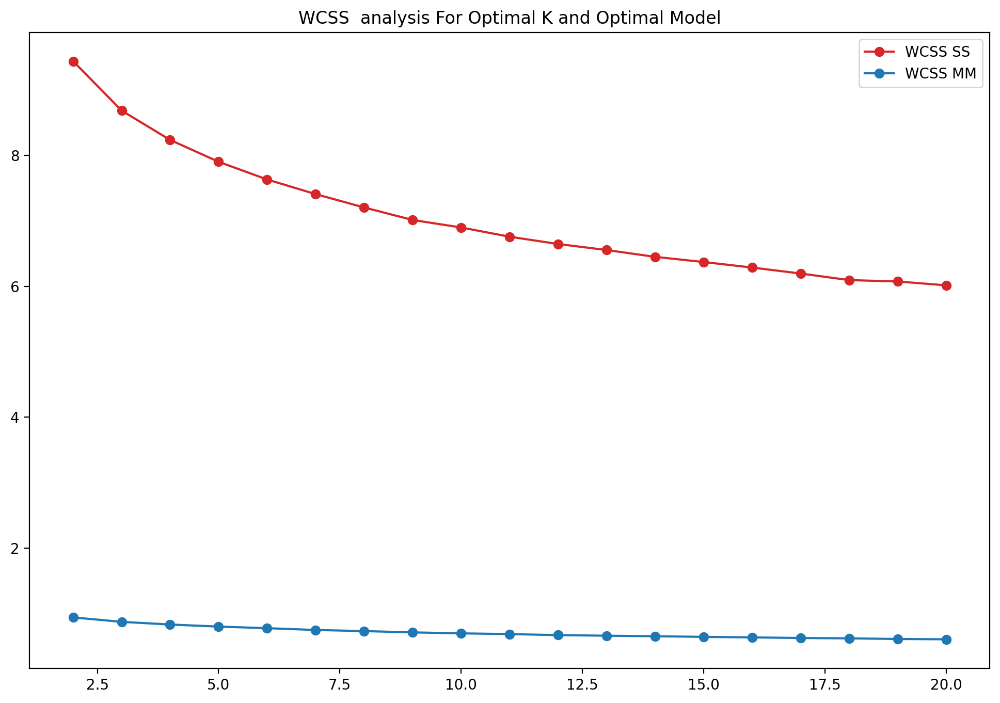

In [14]:
plt.figure(figsize=(12, 8))
plt.plot(range(2, MAX_K+1), wcss_score_euclidean_x_ss, "-o", c="C3")
plt.plot(range(2, MAX_K+1), wcss_score_euclidean_x_mm, "-o", c="C0")
plt.title("WCSS  analysis For Optimal K and Optimal Model")
plt.legend(["WCSS SS", "WCSS MM"]);

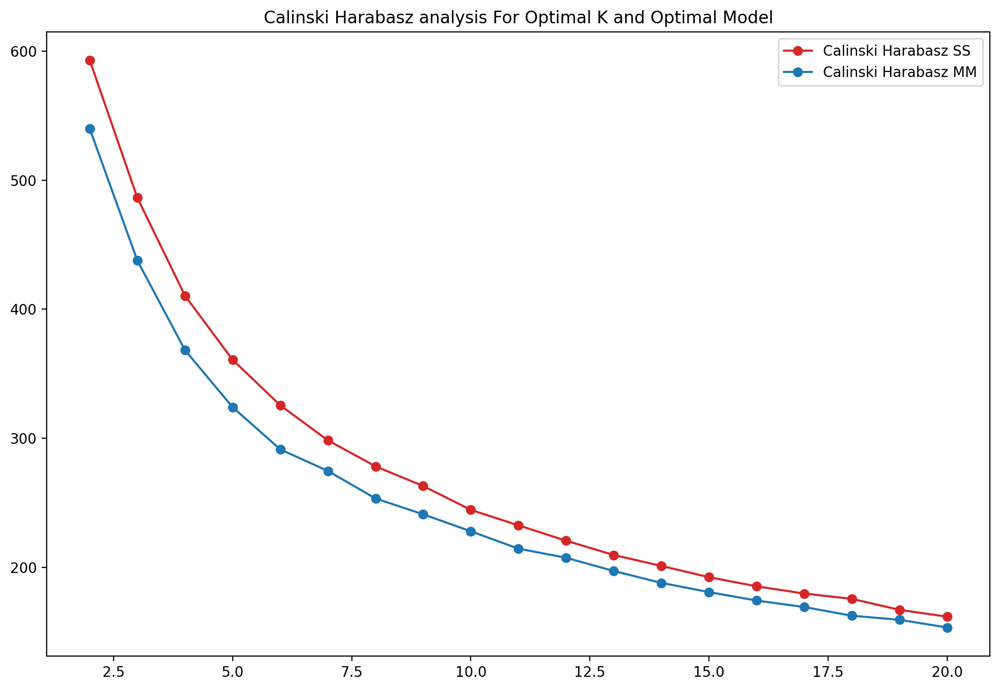

In [15]:
plt.figure(figsize=(12, 8))
plt.plot(range(2, MAX_K+1), calinski_harabasz_euclidean_score_x_ss, "-o", c="C3")
plt.plot(range(2, MAX_K+1), calinski_harabasz_euclidean_score_x_mm, "-o", c="C0")
plt.title("Calinski Harabasz analysis For Optimal K and Optimal Model")
plt.legend(["Calinski Harabasz SS", "Calinski Harabasz MM"]);

find best k

In [16]:
def get_best_calinski_harabasz(results):
    index=0
    for i in range(len(results)):
        if results[i]>results[index]:
            index=i
    return i  

print("The best for the case of ss:",get_best_calinski_harabasz(calinski_harabasz_euclidean_score_x_ss))
print("The best for the case of mm:",get_best_calinski_harabasz(calinski_harabasz_euclidean_score_x_mm))

The best for the case of ss: 18
The best for the case of mm: 18


cluster for best k

In [17]:
def kmeans_cluster(n_clusters,algo,X_train,metric):
    model= TimeSeriesKMeans(n_clusters=n_clusters,
                        metric=metric,
                        n_jobs=-1,
                        random_state=0)
    y_pred = model.fit_predict(X_train)


    for yi in range(len(np.unique(y_pred))):
      for xx in X_train[y_pred == yi]:
        plt.plot(xx.ravel(), "k-", alpha=.2)


      plt.plot(model.cluster_centers_[yi].ravel(), "r-")
      plt.xlim(0, X_train.shape[1])
      plt.ylim(-5, 5)
      plt.text(0.55, 0.85,'Cluster %d' % (yi + 1), transform=plt.gca().transAxes)
      plt.title("kmeans")
      plt.tight_layout()
      plt.savefig(f"{PROJECT_PATH}/reports/figures/fics/{algo}-clusters-{(yi + 1)}-{n_clusters}-{metric}.png")
      plt.show();
  

    for i in range(len(np.unique(y_pred))):
      count = (sum(y_pred == i)/len(y_pred))*100
      print(f"The {count:.2f}% of the observations fall into Cluster {i + 1}")

    return y_pred


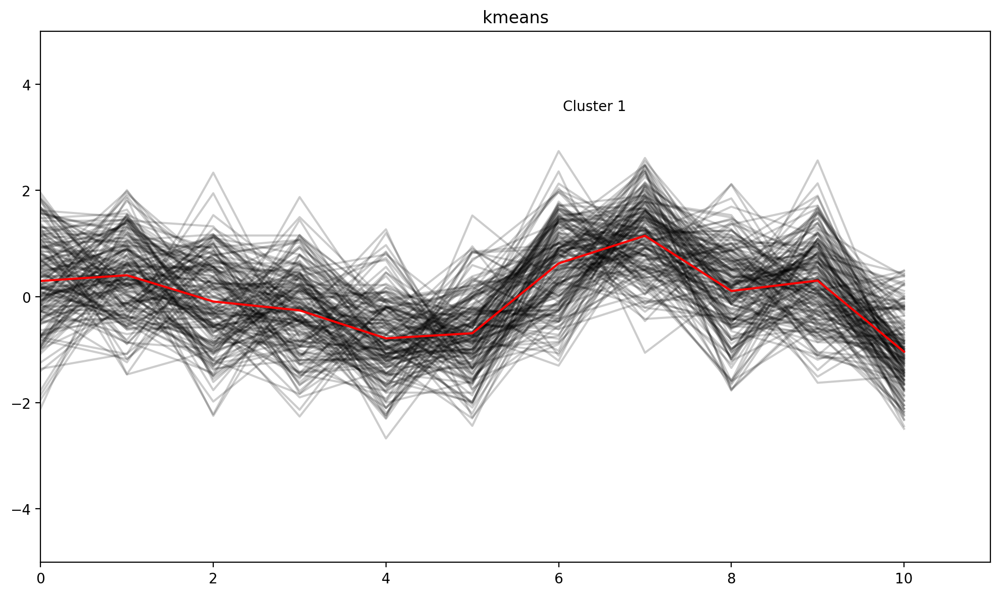

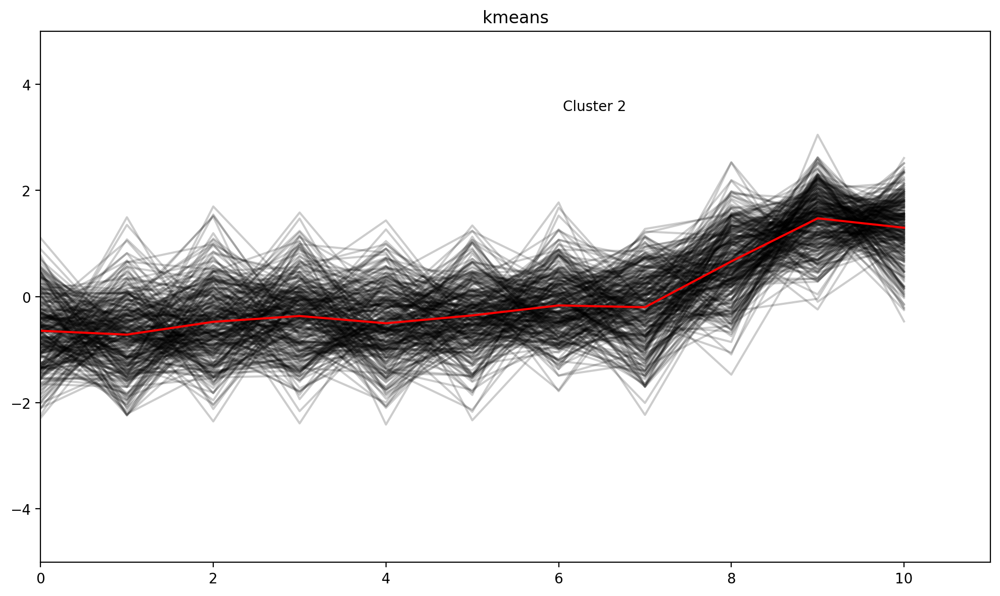

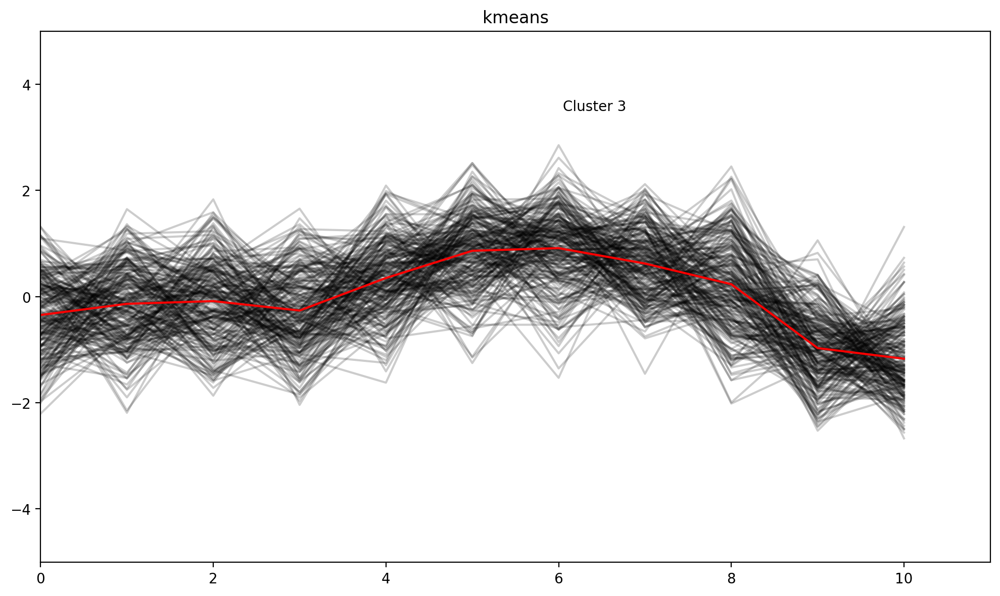

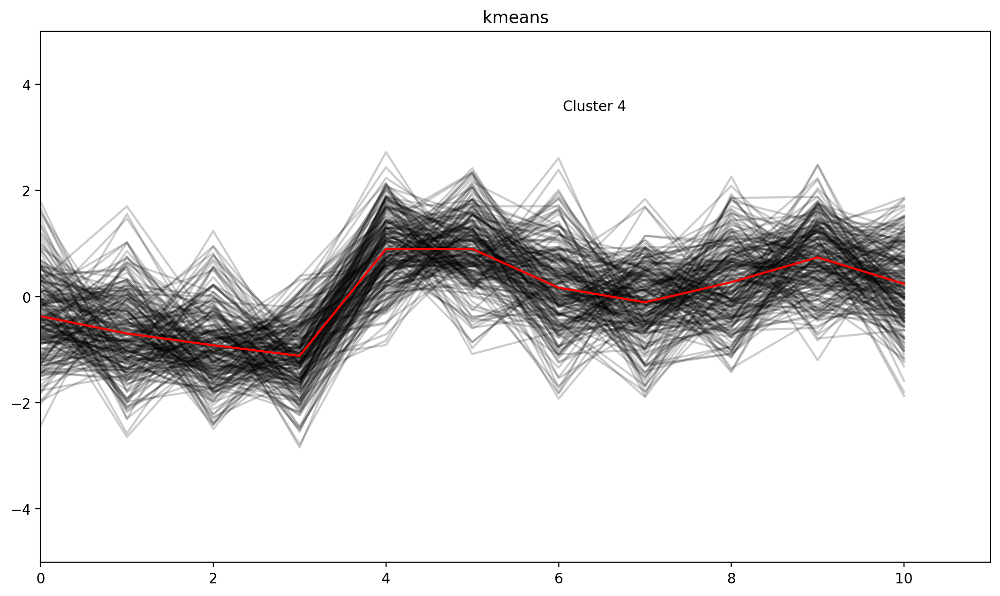

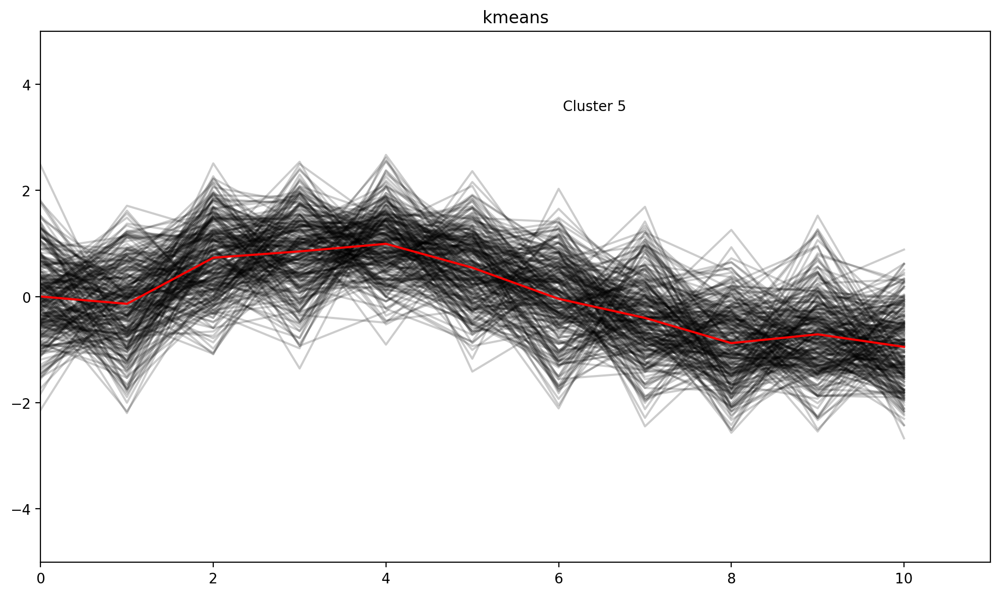

...

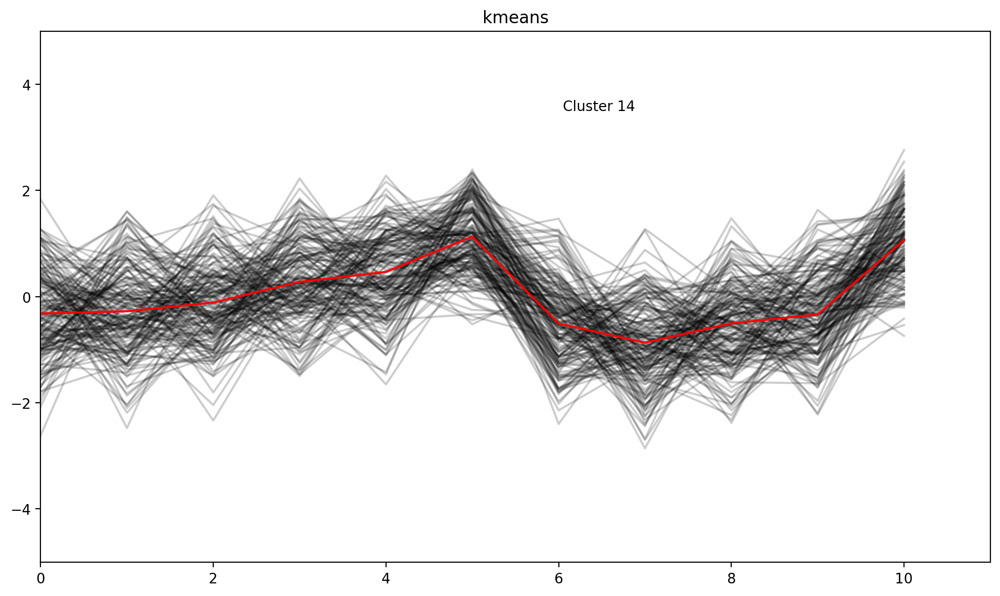

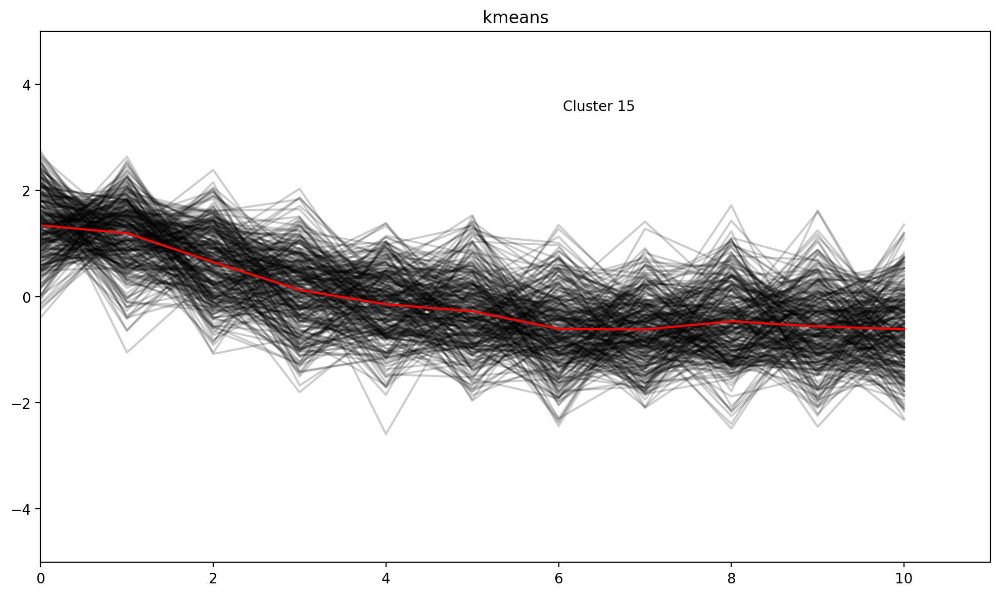

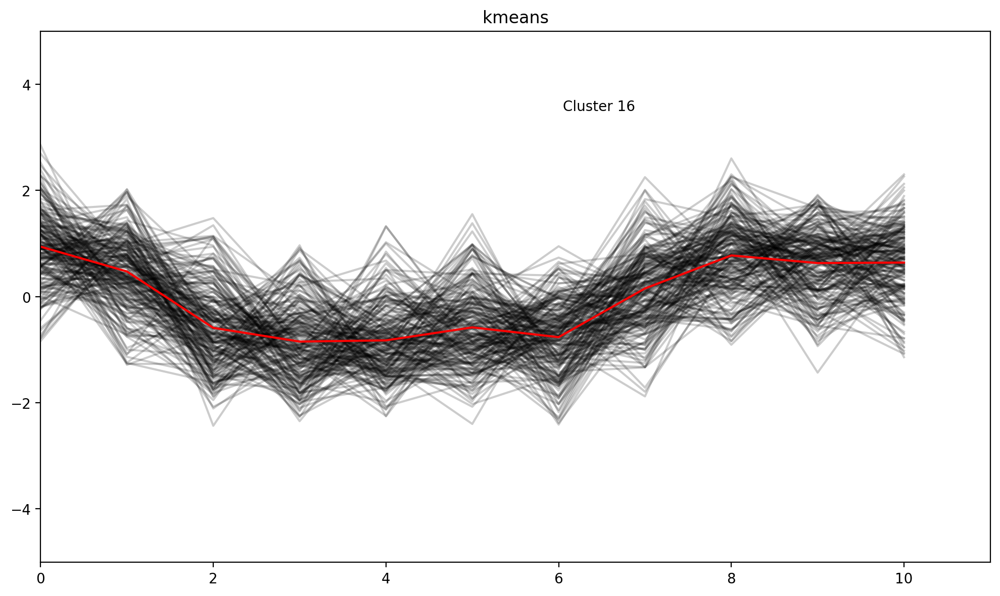

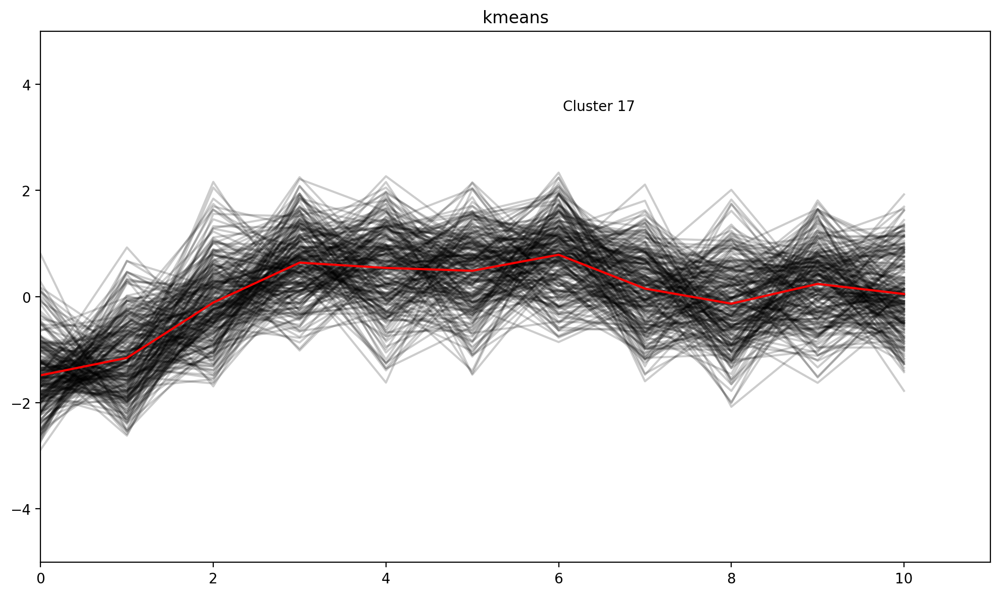

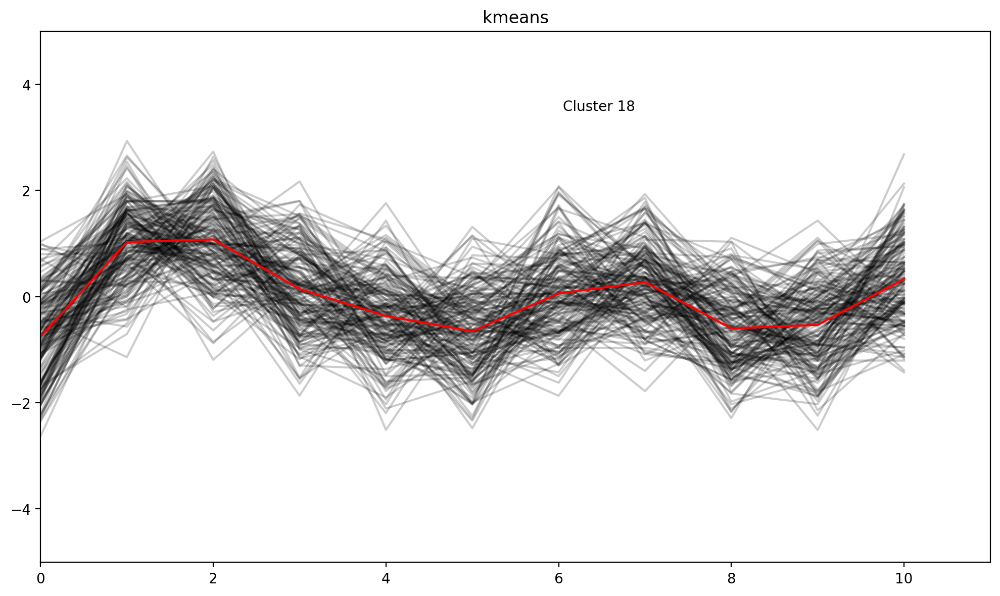

The 4.60% of the observations fall into Cluster 1
The 7.48% of the observations fall into Cluster 2
The 6.08% of the observations fall into Cluster 3
The 5.79% of the observations fall into Cluster 4
The 6.93% of the observations fall into Cluster 5
The 5.23% of the observations fall into Cluster 6
The 7.51% of the observations fall into Cluster 7
The 4.97% of the observations fall into Cluster 8
The 4.52% of the observations fall into Cluster 9
The 4.23% of the observations fall into Cluster 10
The 5.08% of the observations fall into Cluster 11
The 3.97% of the observations fall into Cluster 12
The 4.57% of the observations fall into Cluster 13
The 4.63% of the observations fall into Cluster 14
The 7.80% of the observations fall into Cluster 15
The 5.58% of the observations fall into Cluster 16
The 6.32% of the observations fall into Cluster 17
The 4.73% of the observations fall into Cluster 18


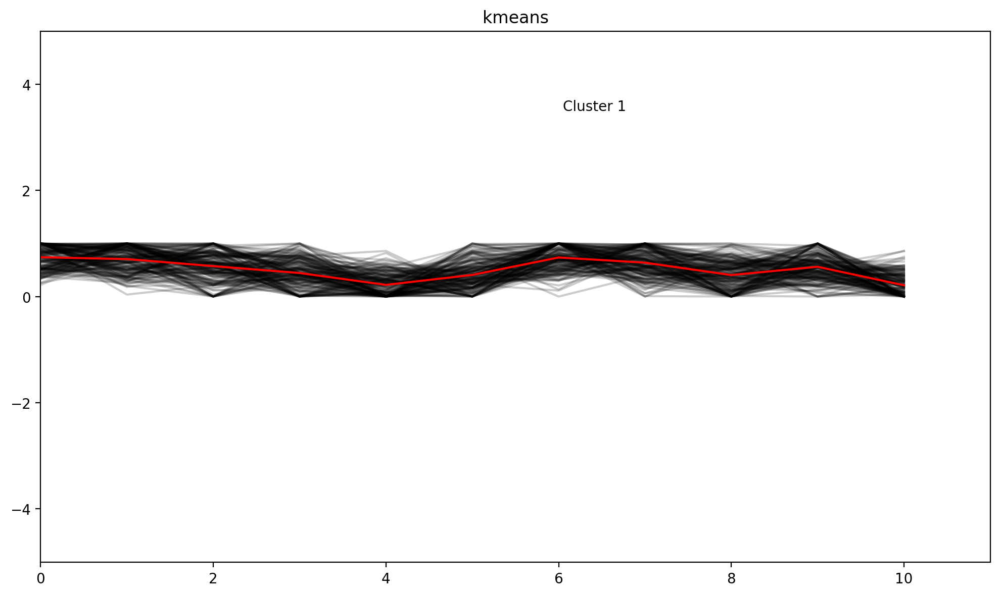

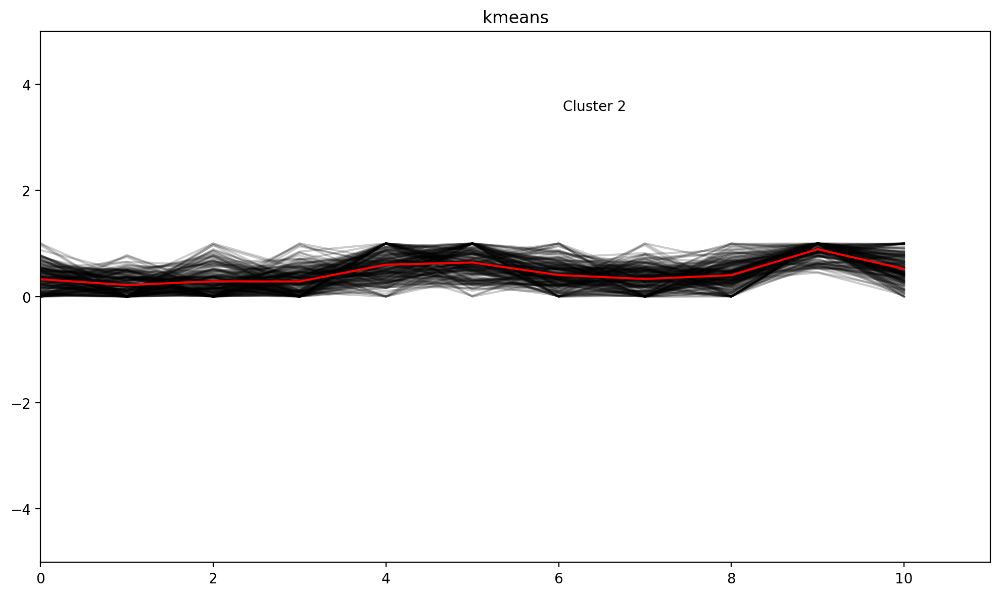

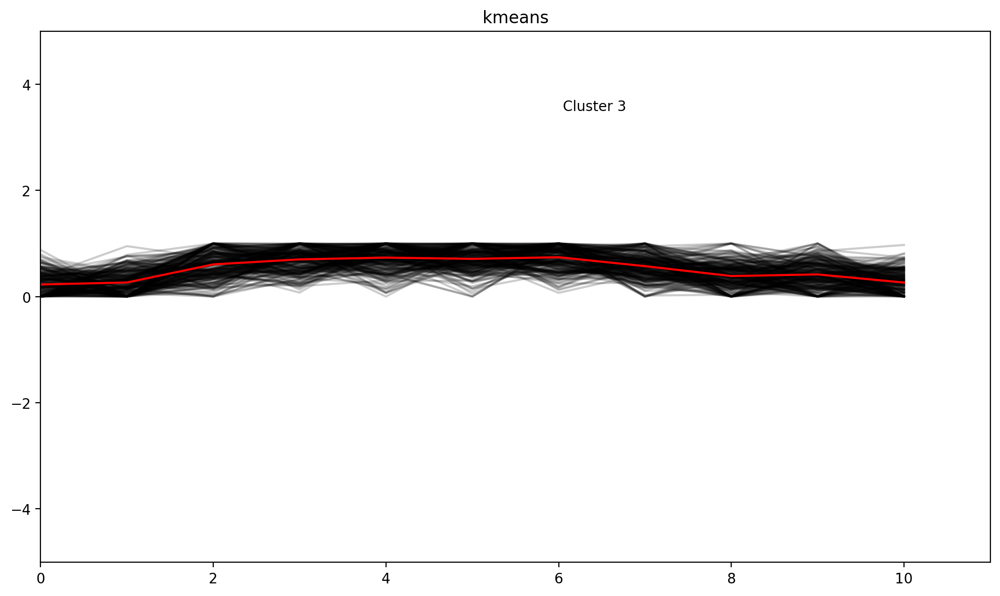

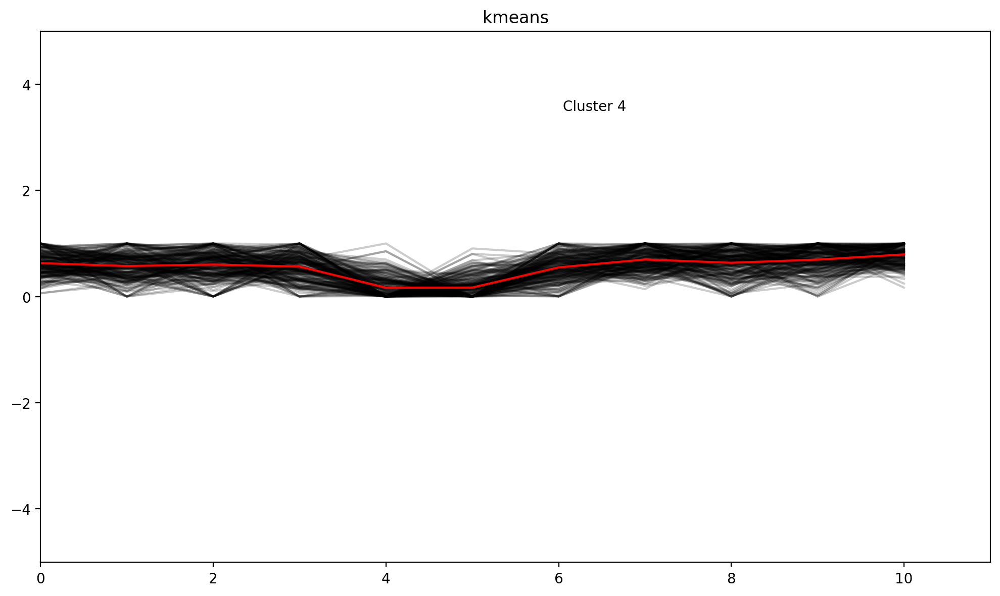

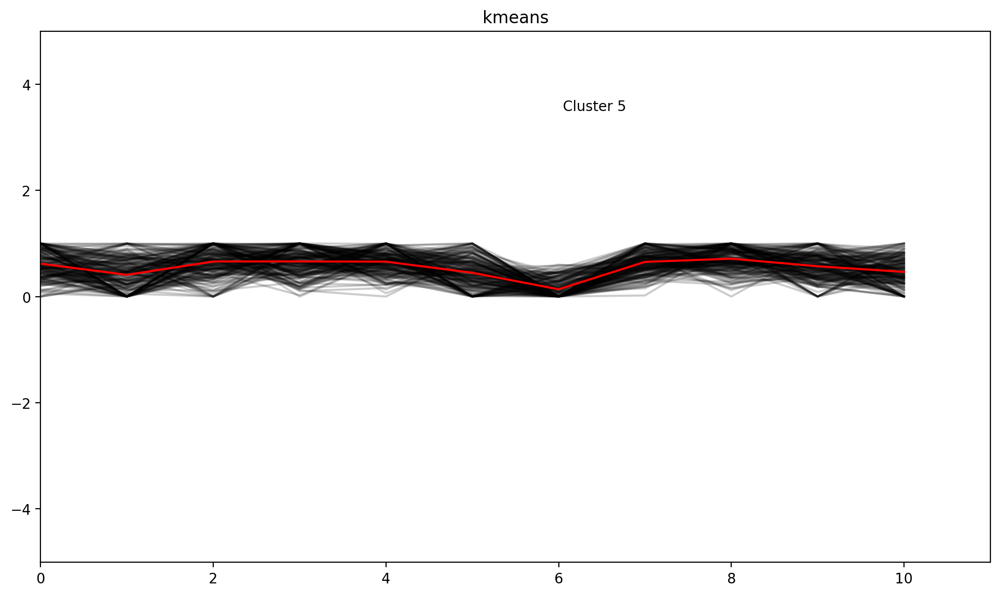

...

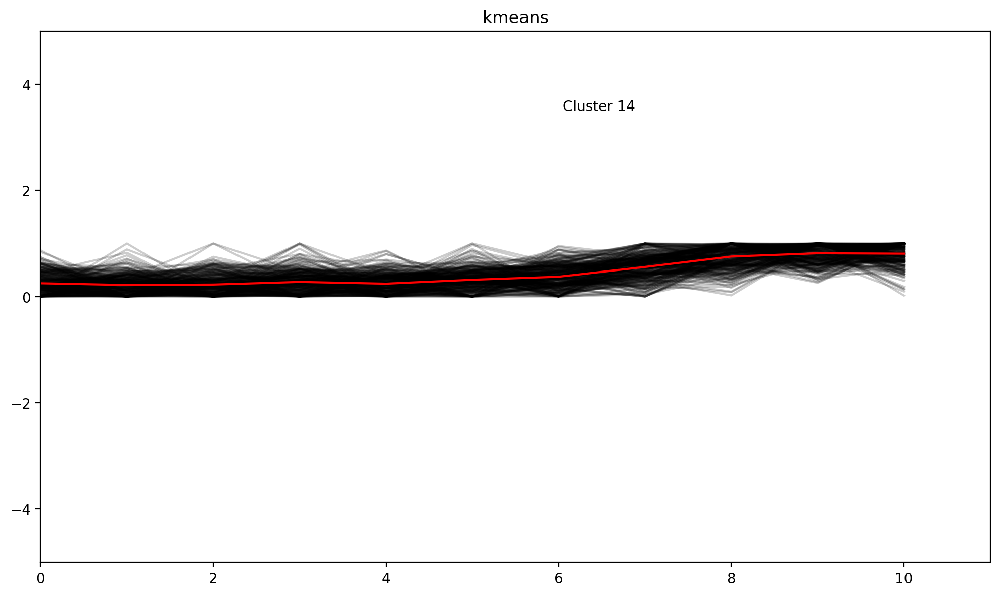

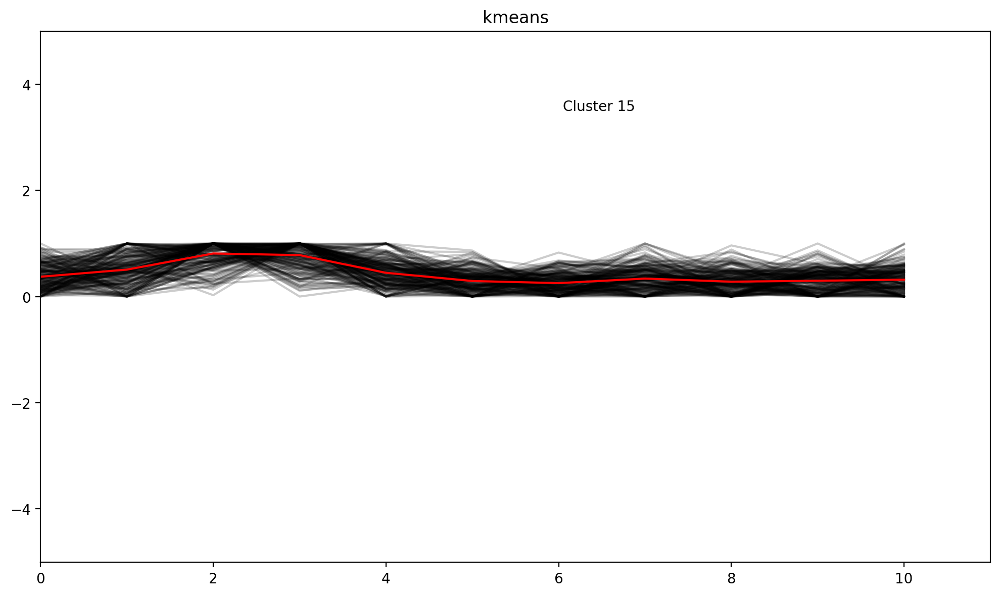

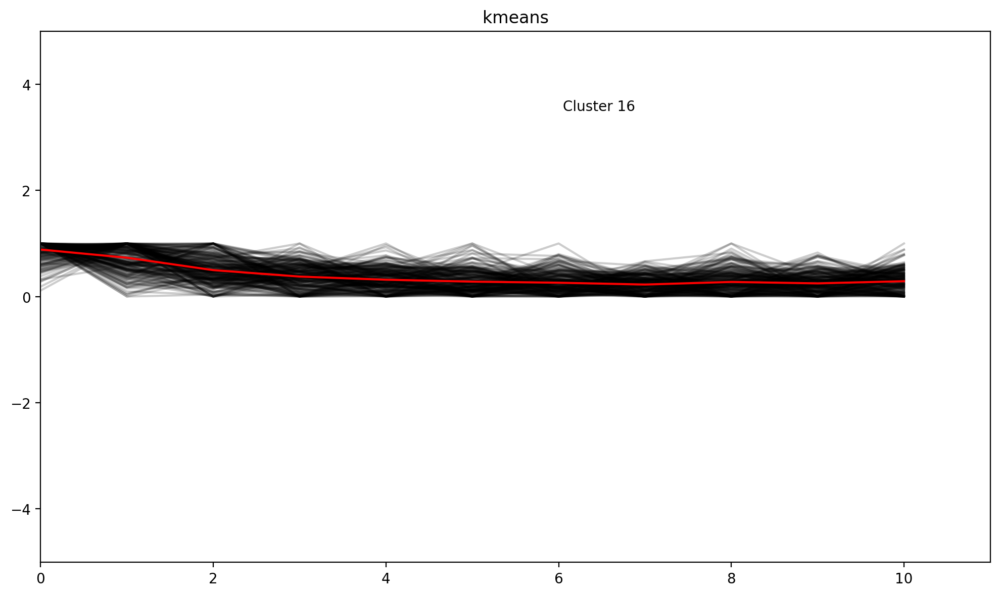

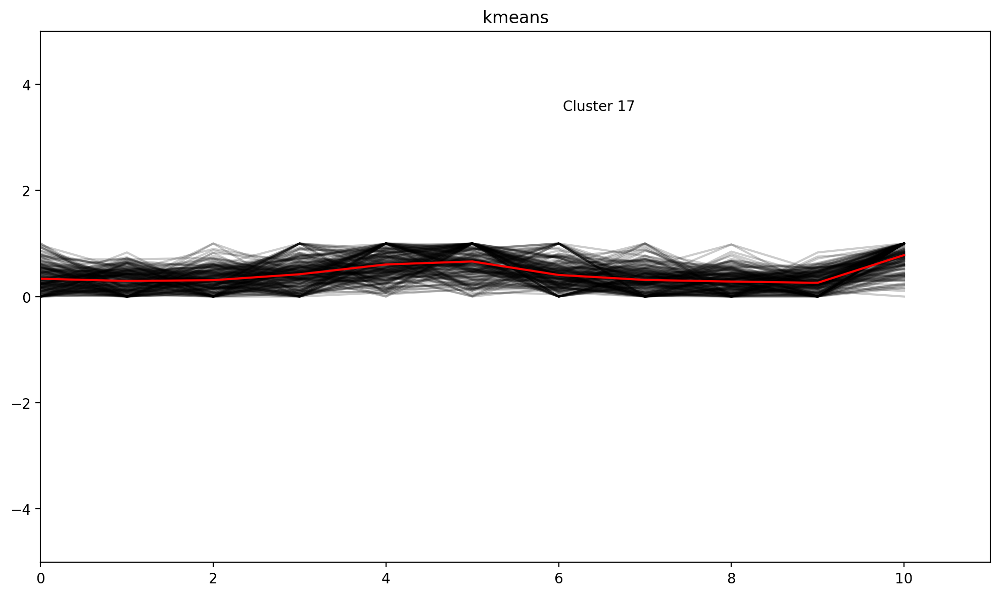

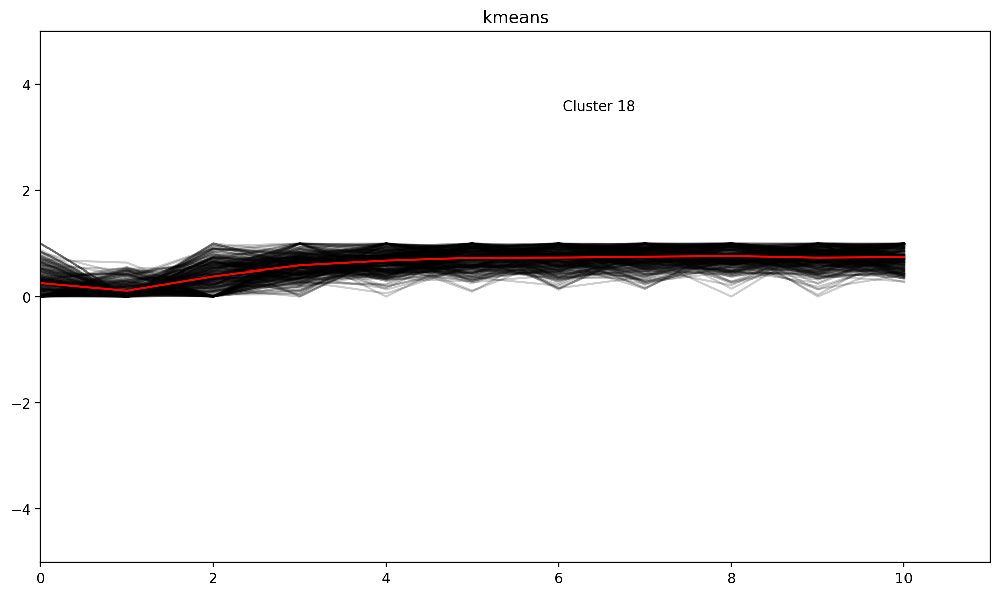

The 4.57% of the observations fall into Cluster 1
The 5.15% of the observations fall into Cluster 2
The 6.53% of the observations fall into Cluster 3
The 5.52% of the observations fall into Cluster 4
The 5.08% of the observations fall into Cluster 5
The 5.82% of the observations fall into Cluster 6
The 5.02% of the observations fall into Cluster 7
The 4.26% of the observations fall into Cluster 8
The 6.42% of the observations fall into Cluster 9
The 4.97% of the observations fall into Cluster 10
The 4.81% of the observations fall into Cluster 11
The 5.87% of the observations fall into Cluster 12
The 5.66% of the observations fall into Cluster 13
The 7.38% of the observations fall into Cluster 14
The 5.15% of the observations fall into Cluster 15
The 5.84% of the observations fall into Cluster 16
The 5.08% of the observations fall into Cluster 17
The 6.87% of the observations fall into Cluster 18


In [18]:
labels_x_ss=kmeans_cluster(18, "euclidean-ss-30",X_ss,"euclidean")
labels_x_mm=kmeans_cluster(18, "euclidean-mm-30",X_mm,"euclidean")

show the cluster

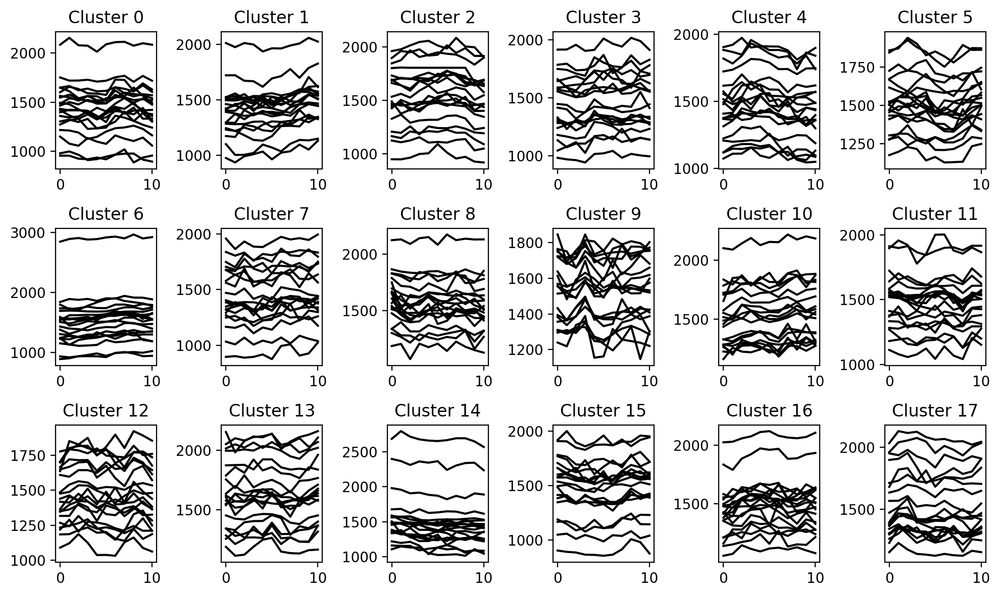

In [21]:
groups=zip(labels_x_ss,X)
my_d_ss={}
for l,s in groups:
    my_d_ss[l]=my_d_ss.get(l,[])
    my_d_ss[l].append(s)
plot_cluster(my_d_ss)

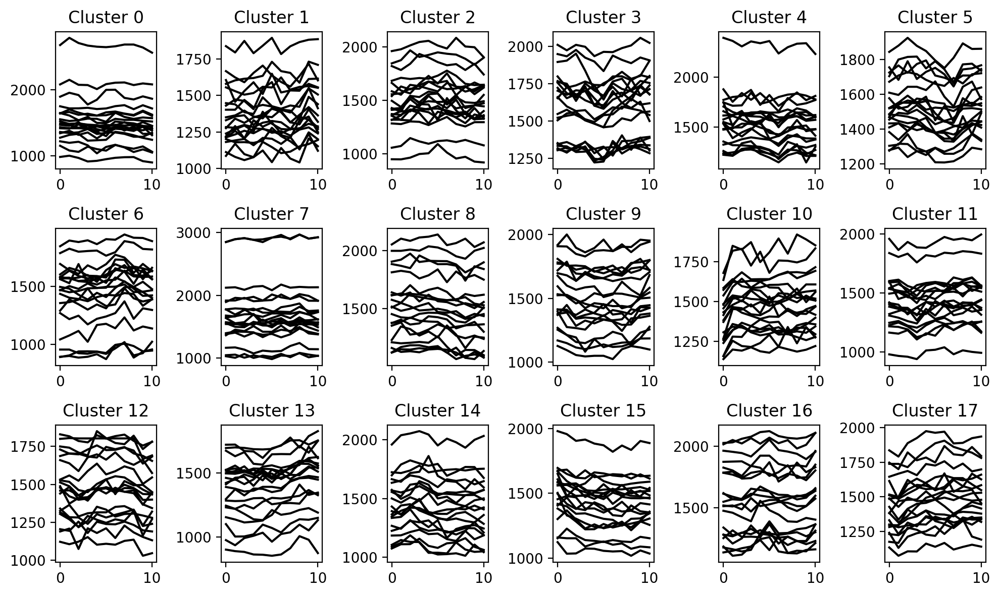

In [22]:
groups=zip(labels_x_mm,X)
my_d_mm={}
for l,s in groups:
    my_d_mm[l]=my_d_mm.get(l,[])
    my_d_mm[l].append(s)
    
plot_cluster(my_d_mm)

save results

In [23]:
df_interval["EuclidanClusterSSID"]=labels_x_ss
df_interval["EuclidanClusterMMID"]=labels_x_mm
df_interval.to_csv(f"{PROJECT_PATH}/data/fics/interim/chess-games-clean-blitz-rated-vfinal-players-interval-30-euclidan-cluster.csv")

In [27]:
wcss_score_dtw_x_ss,calinski_harabasz_dtw_score_x_ss=kmeans_pipeline(X_ss,"dtw",max_k=MAX_K)
wcss_score_dtw_x_mm,calinski_harabasz_dtw_score_x_mm=kmeans_pipeline(X_mm,"dtw",max_k=MAX_K)

5.086288694394144 417.19152373087616
K = 2. Took 58.88 seconds to calculate.
4.536780327970141 341.41901802823713
K = 3. Took 98.56 seconds to calculate.
4.189068517529547 266.09128836879387
K = 4. Took 146.26 seconds to calculate.
3.9881455863384674 221.57960759909074
K = 5. Took 240.03 seconds to calculate.
3.8599560406516753 195.94138054170125
K = 6. Took 252.88 seconds to calculate.
3.728676892865087 169.03139819783453
K = 7. Took 314.72 seconds to calculate.
3.6384210190621435 165.72297416658435
K = 8. Took 348.20 seconds to calculate.
3.5159136813051073 150.0435245309779
K = 9. Took 214.21 seconds to calculate.
3.4323498092817384 138.9168273308906
K = 10. Took 232.14 seconds to calculate.
3.3876214377716622 130.35685531104136
K = 11. Took 263.81 seconds to calculate.
3.312096181942546 121.05578901957372
K = 12. Took 3588.21 seconds to calculate.
3.2491960753811626 111.95861165116453
K = 13. Took 359.94 seconds to calculate.
3.1973768736842185 105.06282589378165
K = 14. Took 523.1

In [26]:
labels_x_ss=kmeans_cluster(18, "dtw-ss-30",X_ss,"dtw")
labels_x_mm=kmeans_cluster(18, "dtw-mm-30",X_mm,"dtw")

KeyboardInterrupt: 

it seems that best best downsamping value is 90 days